Plot the data as a UMAP with specific columns removed. For these data, we only analyze the columns pertaining to acutal kinetic data

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os
import umap
from sklearn.neighbors import NearestNeighbors
import leidenalg as la
import igraph as ig
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'mito_donor_1.xlsx',
    'mito_donor_2.xlsx',
    'mito_donor_3.xlsx',
    'mito_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)


# Function to perform UMAP, KNN, and Leiden clustering on the pooled dataset
def perform_umap_knn_leiden_pooled(df, title):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Create a graph from the UMAP embedding using sparse matrix
    knn_graph = NearestNeighbors(n_neighbors=15).fit(embedding)
    knn_graph_matrix = knn_graph.kneighbors_graph(embedding)
    
    # Convert the graph to an igraph object
    sources, targets = knn_graph_matrix.nonzero()
    edgelist = list(zip(sources.tolist(), targets.tolist()))
    graph = ig.Graph(edgelist)
    
    # Perform Leiden clustering on the graph
    partition = la.find_partition(graph, la.RBConfigurationVertexPartition)
    clusters = np.array(partition.membership)
    
    # Create a DataFrame for the embedding and add cluster and dataset information
    embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
    embedding_df['Cluster'] = clusters
    embedding_df['Dataset'] = df['Dataset'].values
    
    # Plot interactive UMAP with color coding by dataset of origin using Plotly
    fig_dataset = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Dataset', title=f'UMAP Clustering by Dataset - {title}')
    fig_dataset.show()
    
    # Plot interactive UMAP with color coding by Leiden clustering using Plotly
    fig_cluster = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Cluster', title=f'UMAP Clustering by Leiden - {title}')
    fig_cluster.show()
    
    return numeric_df, clusters, embedding

# Perform UMAP, KNN, and Leiden clustering on the pooled dataset and create interactive plots
perform_umap_knn_leiden_pooled(pooled_df, "Pooled Datasets")

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


(       LONGEST_GAP  TRACK_DISPLACEMENT  TRACK_MEAN_SPEED  TRACK_MAX_SPEED  \
 0                4          148.470000          1.908235        12.635140   
 1                3           50.489550          0.741130        11.967430   
 2                1            2.851995          1.207850         3.878256   
 3                1           12.561160          0.707856         8.467034   
 4                0            3.524819          0.714459         2.453060   
 ...            ...                 ...               ...              ...   
 11643            0            0.215612          0.215612         0.215612   
 11644            0            0.475722          0.475722         0.475722   
 11645            0            0.378915          0.378915         0.378915   
 11646            0            0.330120          0.330120         0.330120   
 11647            0            0.088303          0.088303         0.088303   
 
        TRACK_MIN_SPEED  TRACK_MEDIAN_SPEED  TRACK_STD_SPEED  

Plot non-interactable UMAPS

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



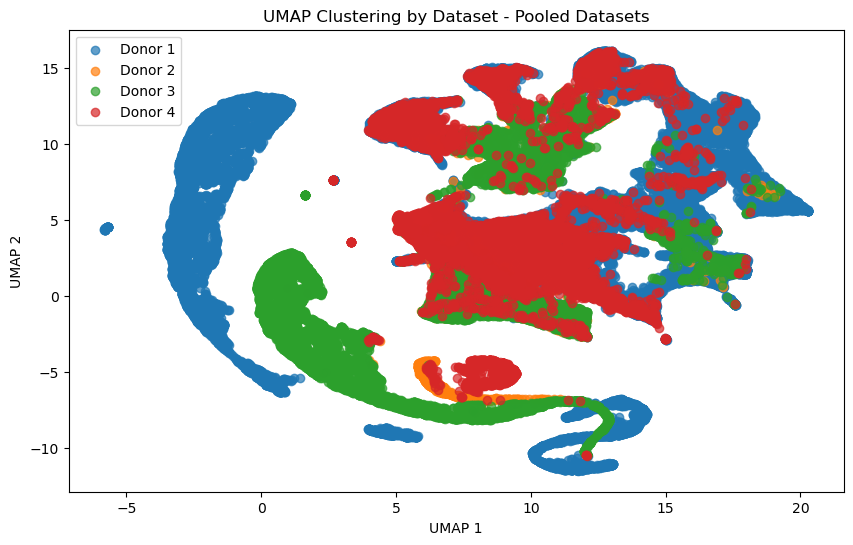

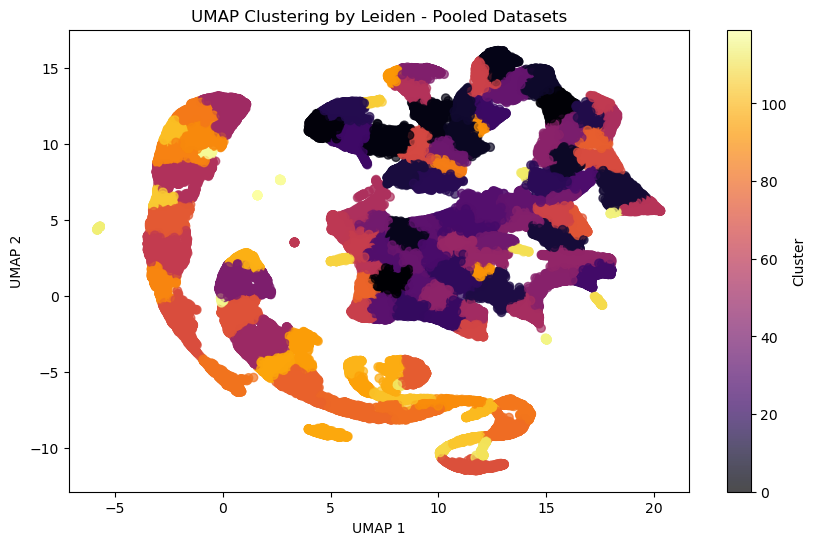

(       LONGEST_GAP  TRACK_DISPLACEMENT  TRACK_MEAN_SPEED  TRACK_MAX_SPEED  \
 0                4          148.470000          1.908235        12.635140   
 1                3           50.489550          0.741130        11.967430   
 2                1            2.851995          1.207850         3.878256   
 3                1           12.561160          0.707856         8.467034   
 4                0            3.524819          0.714459         2.453060   
 ...            ...                 ...               ...              ...   
 11643            0            0.215612          0.215612         0.215612   
 11644            0            0.475722          0.475722         0.475722   
 11645            0            0.378915          0.378915         0.378915   
 11646            0            0.330120          0.330120         0.330120   
 11647            0            0.088303          0.088303         0.088303   
 
        TRACK_MIN_SPEED  TRACK_MEDIAN_SPEED  TRACK_STD_SPEED  

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os
import umap
from sklearn.neighbors import NearestNeighbors
import leidenalg as la
import igraph as ig

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove columns
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION','TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP, KNN, and Leiden clustering on the pooled dataset
def perform_umap_knn_leiden_pooled(df, title):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Create a graph from the UMAP embedding using sparse matrix
    knn_graph = NearestNeighbors(n_neighbors=15).fit(embedding)
    knn_graph_matrix = knn_graph.kneighbors_graph(embedding)
    
    # Convert the graph to an igraph object
    sources, targets = knn_graph_matrix.nonzero()
    edgelist = list(zip(sources.tolist(), targets.tolist()))
    graph = ig.Graph(edgelist)
    
    # Perform Leiden clustering on the graph
    partition = la.find_partition(graph, la.RBConfigurationVertexPartition)
    clusters = np.array(partition.membership)
    
    # Create a DataFrame for the embedding and add cluster and dataset information
    embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
    embedding_df['Cluster'] = clusters
    embedding_df['Dataset'] = df['Dataset'].values
    
    # Plot non-interactive UMAP with color coding by dataset of origin using Matplotlib
    plt.figure(figsize=(10, 6))
    for dataset in embedding_df['Dataset'].unique():
        subset = embedding_df[embedding_df['Dataset'] == dataset]
        plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=dataset, alpha=0.7)
    plt.title(f'UMAP Clustering by Dataset - {title}')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.legend()
    plt.show()
    
    # Plot non-interactive UMAP with color coding by Leiden clustering using Matplotlib
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(embedding_df['UMAP 1'], embedding_df['UMAP 2'], c=embedding_df['Cluster'], cmap='inferno', alpha=0.7)
    plt.colorbar(label='Cluster')
    plt.title(f'UMAP Clustering by Leiden - {title}')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.show()
    
    return numeric_df, clusters, embedding

# Perform UMAP, KNN, and Leiden clustering on the pooled dataset and create non-interactive plots
perform_umap_knn_leiden_pooled(pooled_df, "Pooled Datasets")



Plot UMAPs donor by donor

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



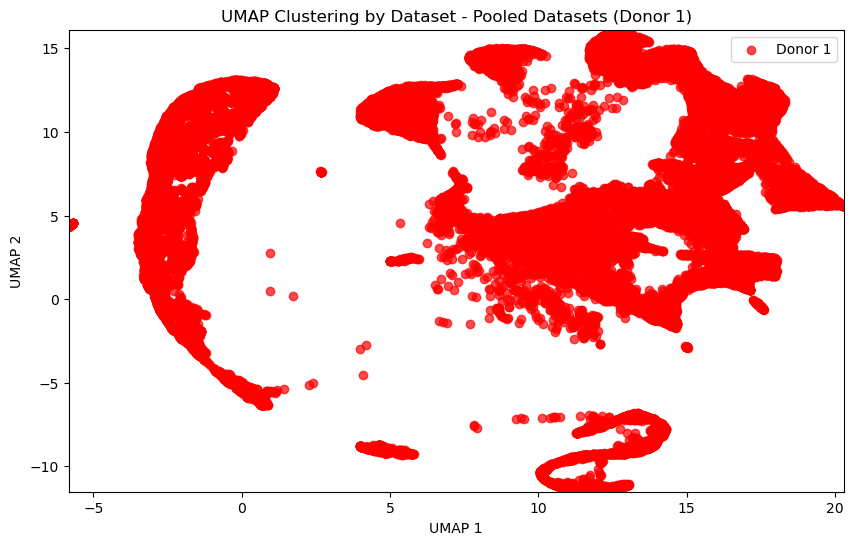

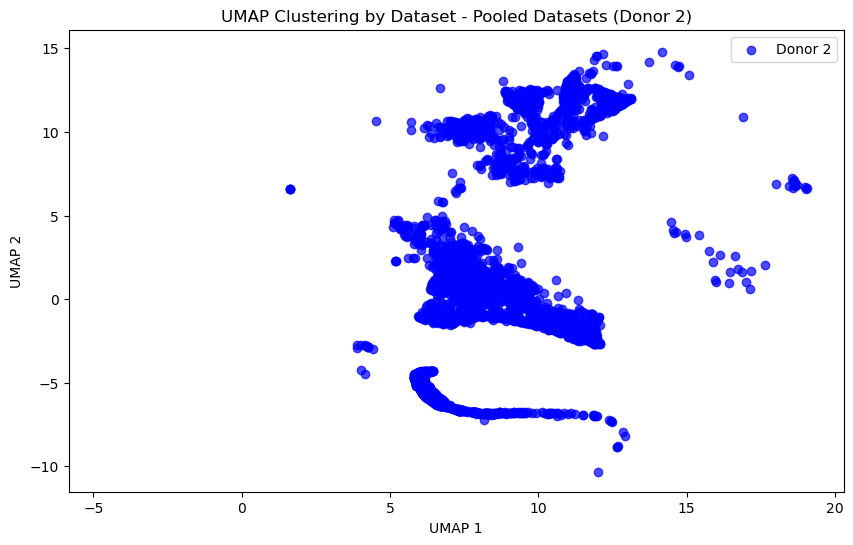

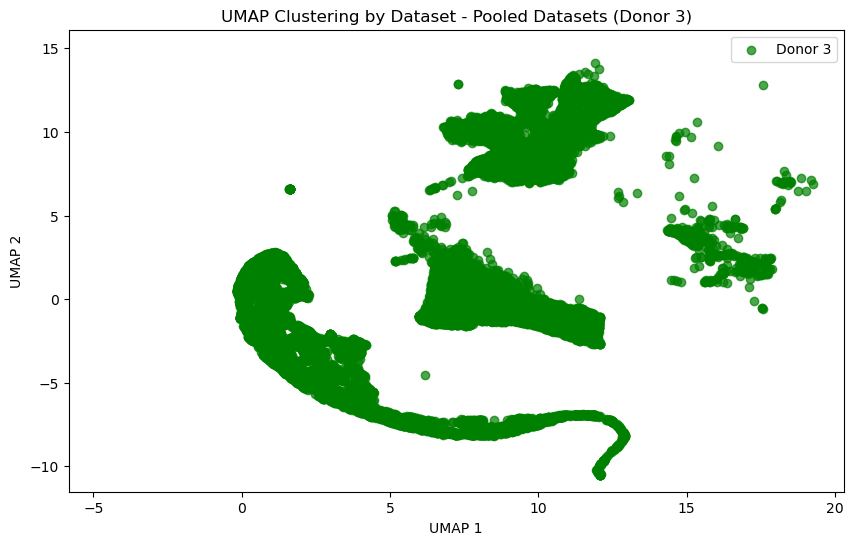

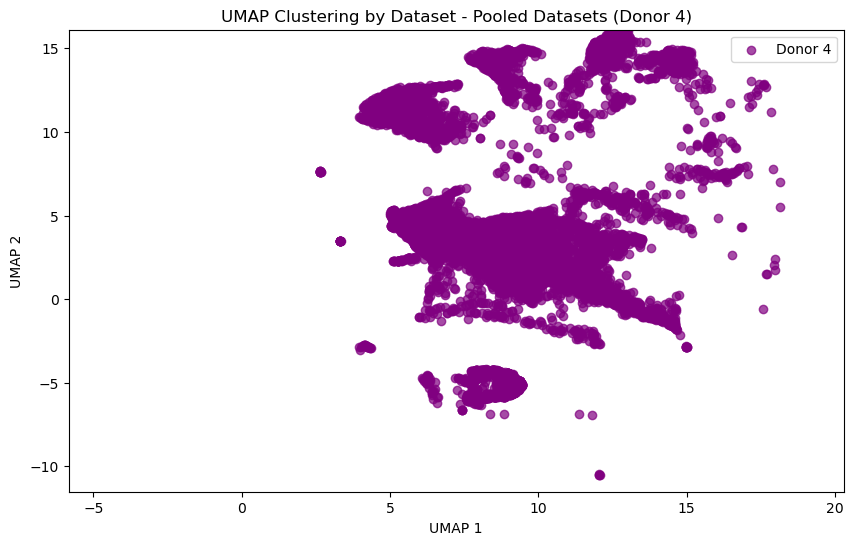

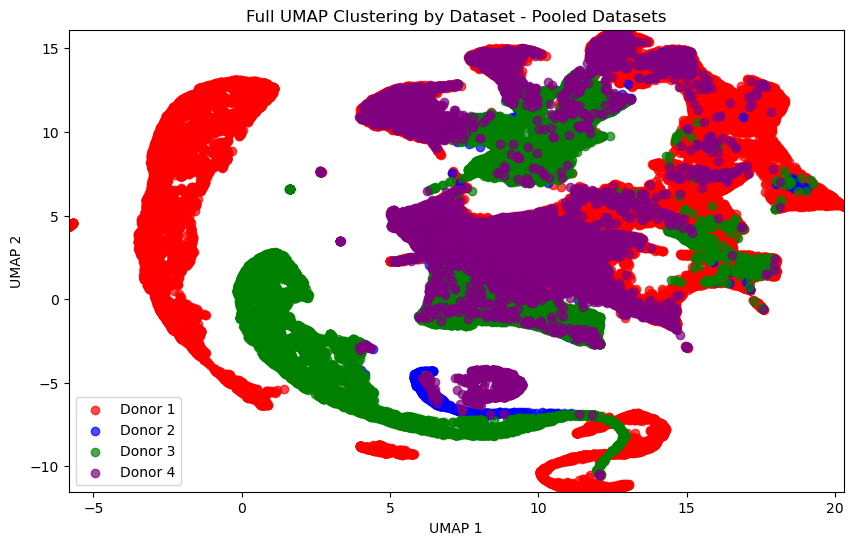

(       LONGEST_GAP  TRACK_DISPLACEMENT  TRACK_MEAN_SPEED  TRACK_MAX_SPEED  \
 0                4          148.470000          1.908235        12.635140   
 1                3           50.489550          0.741130        11.967430   
 2                1            2.851995          1.207850         3.878256   
 3                1           12.561160          0.707856         8.467034   
 4                0            3.524819          0.714459         2.453060   
 ...            ...                 ...               ...              ...   
 11643            0            0.215612          0.215612         0.215612   
 11644            0            0.475722          0.475722         0.475722   
 11645            0            0.378915          0.378915         0.378915   
 11646            0            0.330120          0.330120         0.330120   
 11647            0            0.088303          0.088303         0.088303   
 
        TRACK_MIN_SPEED  TRACK_MEDIAN_SPEED  TRACK_STD_SPEED  

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove columns
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION','TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset and display one donor at a time with the same coordinate scale and different colors
def perform_umap_pooled(df, title):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    # Create a DataFrame for the embedding and add dataset information
    embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
    embedding_df['Dataset'] = df['Dataset'].values
    
    # Determine the coordinate limits for consistent scaling
    x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
    y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()
    
    # Define colors for each donor
    colors = ['red', 'blue', 'green', 'purple']
    
    # Plot non-interactive UMAP with color coding by dataset of origin using Matplotlib, one donor at a time with consistent scaling and different colors
    for i, dataset in enumerate(embedding_df['Dataset'].unique()):
        plt.figure(figsize=(10, 6))
        subset = embedding_df[embedding_df['Dataset'] == dataset]
        plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=dataset, color=colors[i], alpha=0.7)
        plt.title(f'UMAP Clustering by Dataset - {title} ({dataset})')
        plt.xlabel('UMAP 1')
        plt.ylabel('UMAP 2')
        plt.xlim(x_min, x_max)
        plt.ylim(y_min, y_max)
        plt.legend()
        plt.show()
    
    # Plot full UMAP with color coding by dataset of origin using Matplotlib with consistent scaling and different colors
    plt.figure(figsize=(10, 6))
    for i, dataset in enumerate(embedding_df['Dataset'].unique()):
        subset = embedding_df[embedding_df['Dataset'] == dataset]
        plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=dataset, color=colors[i], alpha=0.7)
    plt.title(f'Full UMAP Clustering by Dataset - {title}')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.legend()
    plt.show()
    
    return numeric_df, embedding

# Perform UMAP on the pooled dataset and create non-interactive plots for each donor separately with consistent scaling and different colors
perform_umap_pooled(pooled_df, "Pooled Datasets")



c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



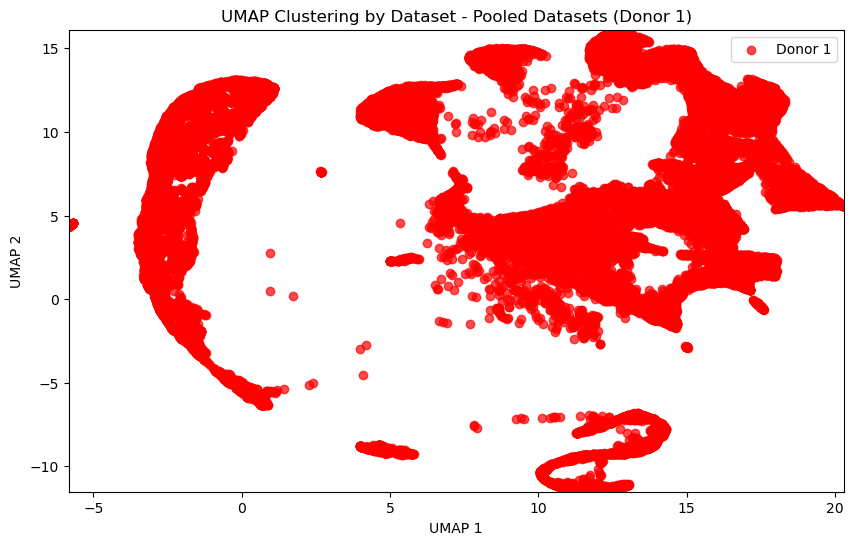

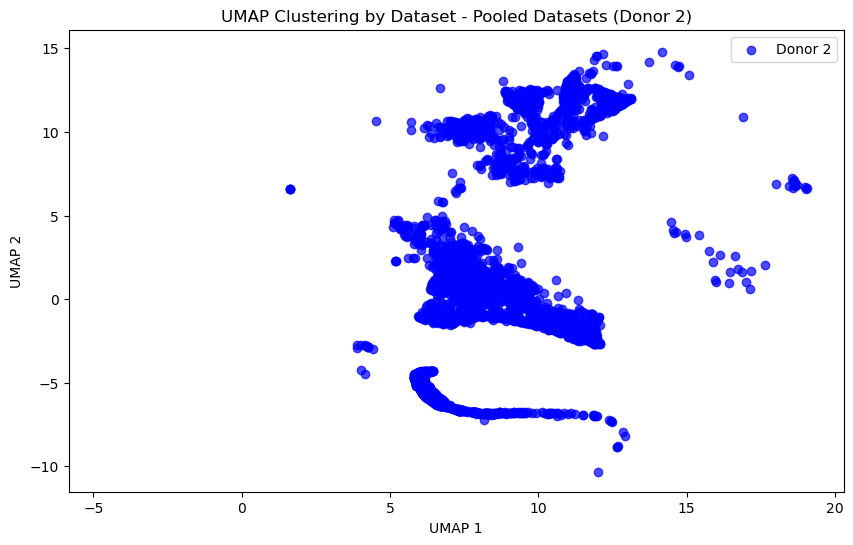

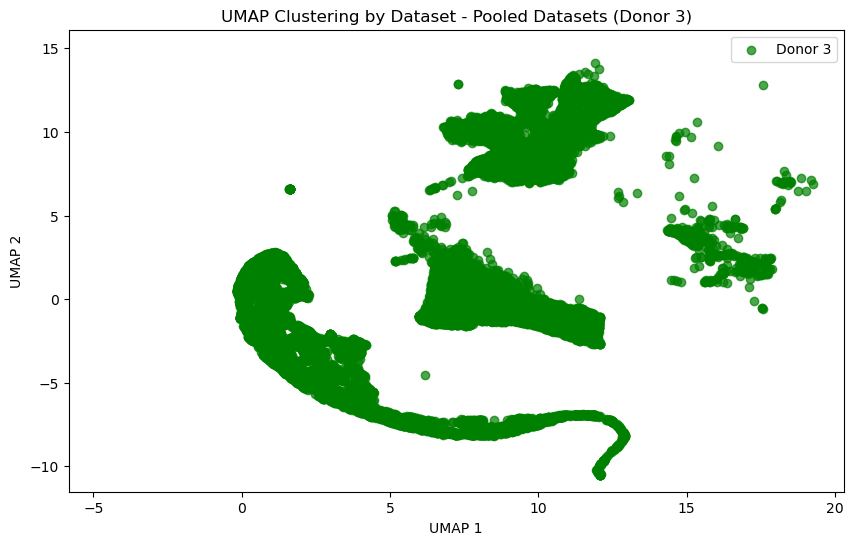

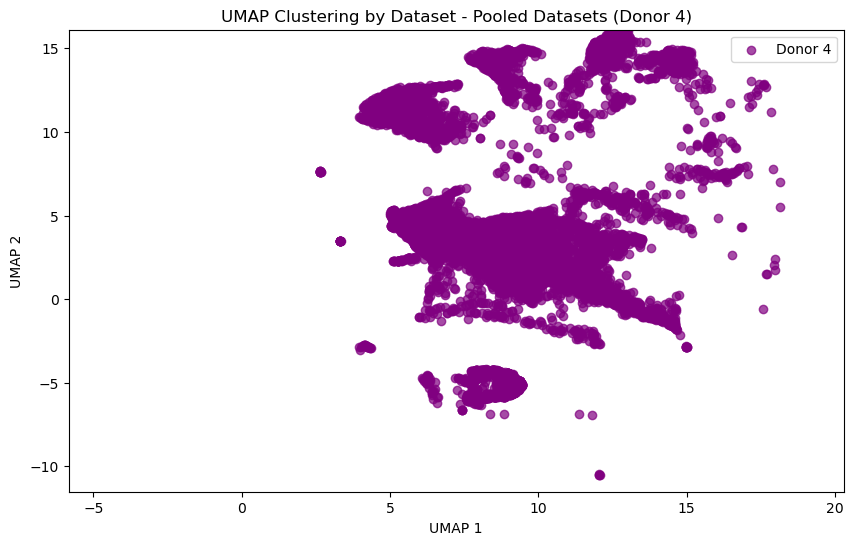

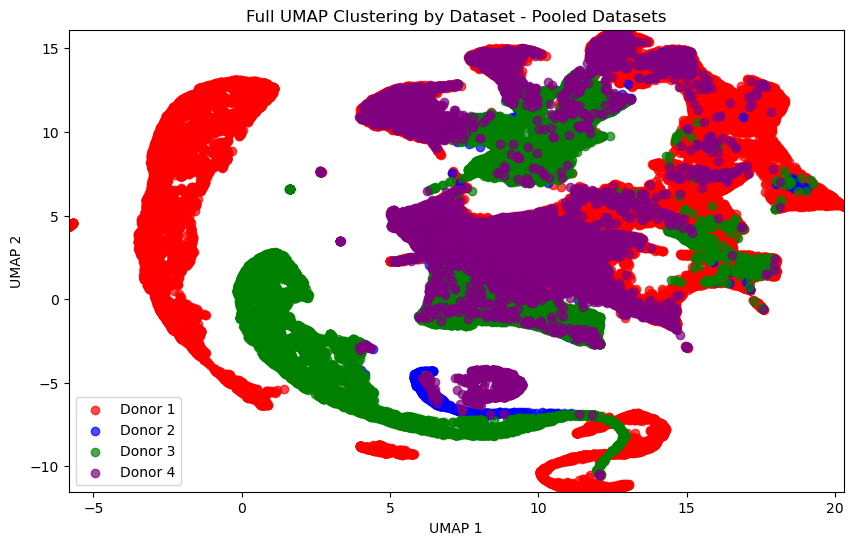

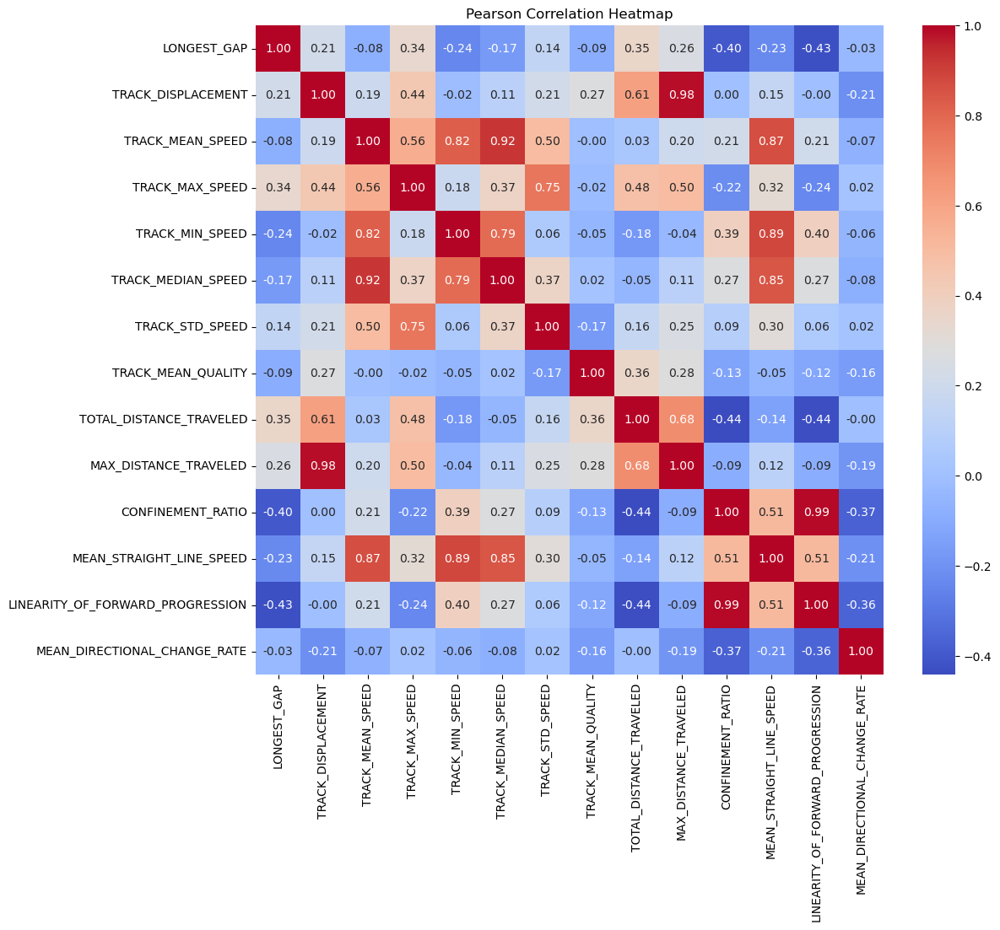

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, NUMBER_GAPS from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding

# Perform UMAP on the pooled dataset
embedding = perform_umap(pooled_df)

# Create a DataFrame for the embedding and add dataset information
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Define colors for each donor
colors = ['red', 'blue', 'green', 'purple']

# Plot non-interactive UMAP with color coding by dataset of origin using Matplotlib, one donor at a time with consistent scaling and different colors
for i, dataset in enumerate(embedding_df['Dataset'].unique()):
    plt.figure(figsize=(10, 6))
    subset = embedding_df[embedding_df['Dataset'] == dataset]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=dataset, color=colors[i], alpha=0.7)
    plt.title(f'UMAP Clustering by Dataset - Pooled Datasets ({dataset})')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.legend()
    plt.show()

# Plot full UMAP with color coding by dataset of origin using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
for i, dataset in enumerate(embedding_df['Dataset'].unique()):
    subset = embedding_df[embedding_df['Dataset'] == dataset]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=dataset, color=colors[i], alpha=0.7)
plt.title('Full UMAP Clustering by Dataset - Pooled Datasets')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()

# Run Pearson correlation to determine parameter correlation and display as a heatmap
correlation_matrix = pooled_df.iloc[:, 3:-1].corr(method='pearson')

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Pearson Correlation Heatmap')
plt.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


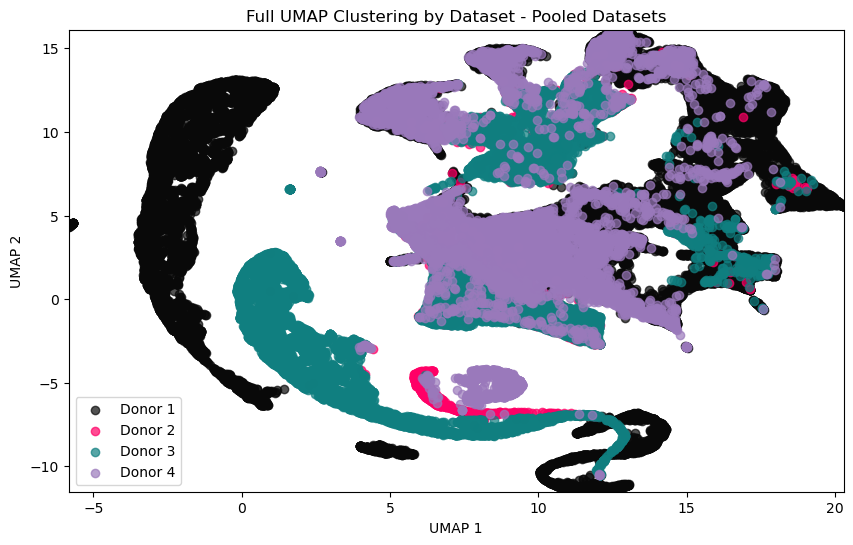

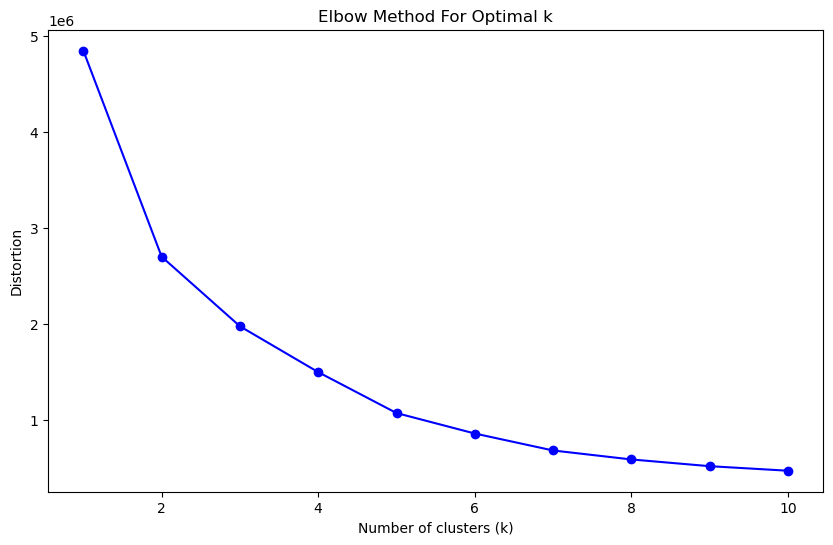

In [16]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, NUMBER_GAPS, NUMBER_COMPLEX from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding

# Perform UMAP on the pooled dataset
embedding = perform_umap(pooled_df)

# Create a DataFrame for the embedding and add dataset information
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Define RGB colors for each donor (values from 0-255)
donor_colors = {
    'Donor 1': (9, 9, 9),       # Black
    'Donor 2': (255, 0, 102),   # Pink
    'Donor 3': (16, 127, 128),  # Green
    'Donor 4': (154, 121, 187)  # Purple
}

# Normalize RGB values to the range 0-1
donor_colors = {k: tuple(np.array(v) / 255) for k, v in donor_colors.items()}

# Plot full UMAP with color coding by dataset of origin using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
for donor in pooled_df['Dataset'].unique():
    subset = embedding_df[embedding_df['Dataset'] == donor]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=donor, color=donor_colors[donor], alpha=0.7)
plt.title('Full UMAP Clustering by Dataset - Pooled Datasets')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()

# Elbow plot to identify optimal number of clusters using KMeans
def plot_elbow_curve(data):
    distortions = []
    K = range(1, 11)
    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        distortions.append(kmeans.inertia_)
    
    plt.figure(figsize=(10, 6))
    plt.plot(K, distortions, 'bo-')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Distortion')
    plt.title('Elbow Method For Optimal k')
    plt.show()

# Plot elbow curve using the UMAP embedding data
plot_elbow_curve(embedding)

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



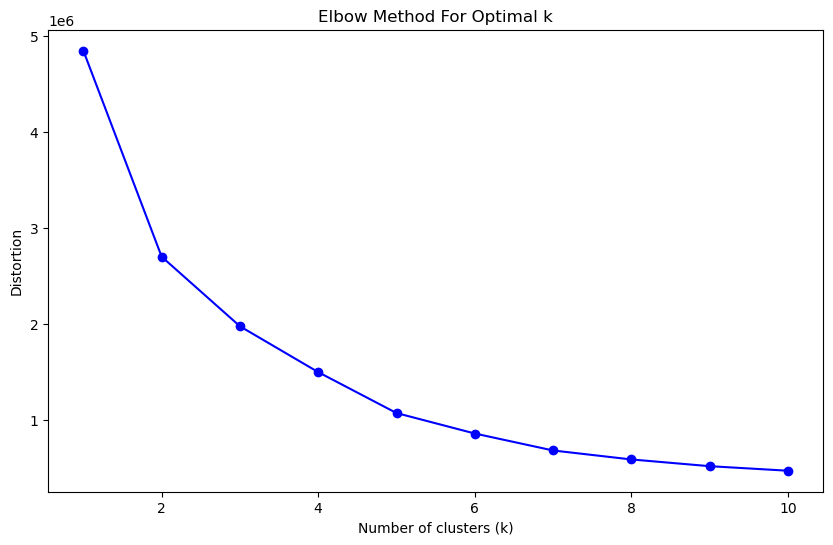

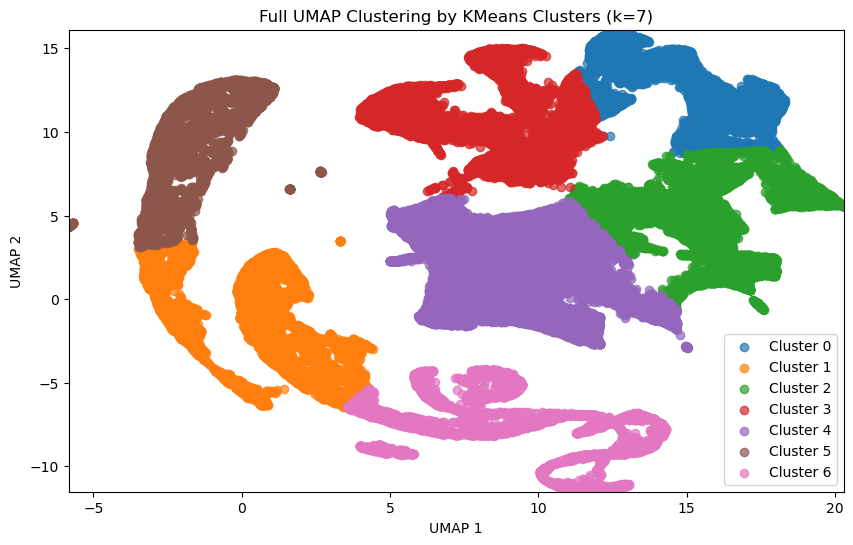

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, NUMBER_GAPS, NUMBER_COMPLEX from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding

# Perform UMAP on the pooled dataset
embedding = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Elbow plot to identify optimal number of clusters using KMeans
def plot_elbow_curve(data):
    distortions = []
    K = range(1, 11)
    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        distortions.append(kmeans.inertia_)
    
    plt.figure(figsize=(10, 6))
    plt.plot(K, distortions, 'bo-')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Distortion')
    plt.title('Elbow Method For Optimal k')
    plt.show()
    
    return distortions

# Plot elbow curve using the UMAP embedding data and determine optimal number of clusters
distortions = plot_elbow_curve(embedding)

# Determine the optimal number of clusters (k) from the elbow plot (manually identified here as an example)
optimal_k = 7

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Add cluster information to the embedding DataFrame
embedding_df['Cluster'] = clusters


# Plot full UMAP with color coding by KMeans clusters using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    subset = embedding_df[embedding_df['Cluster'] == i]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {i}', alpha=0.7)
plt.title(f'Full UMAP Clustering by KMeans Clusters (k={optimal_k})')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


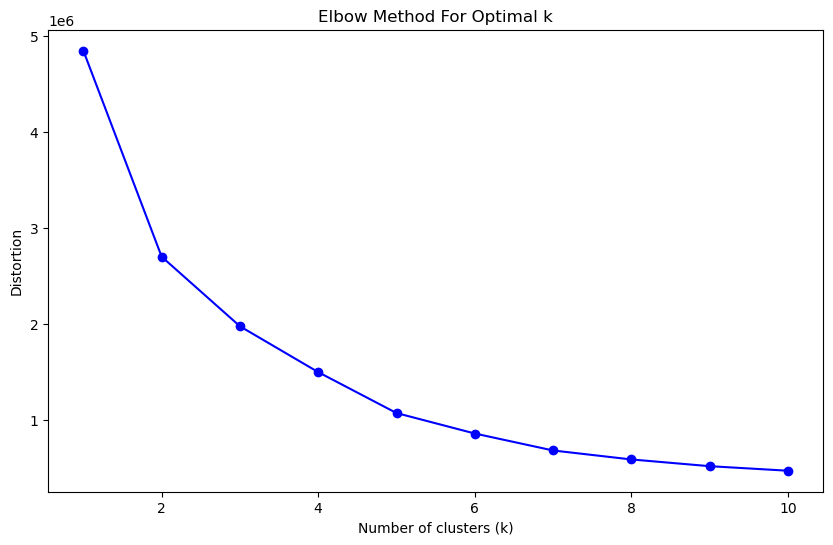

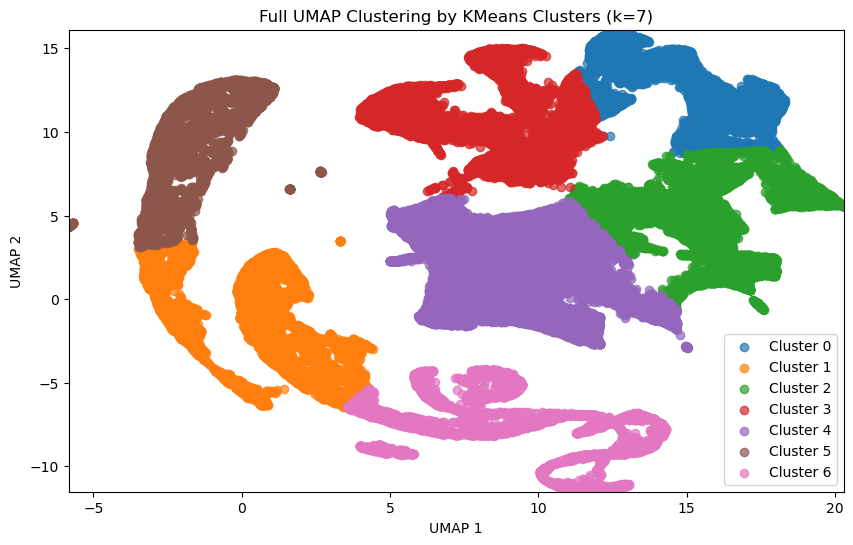

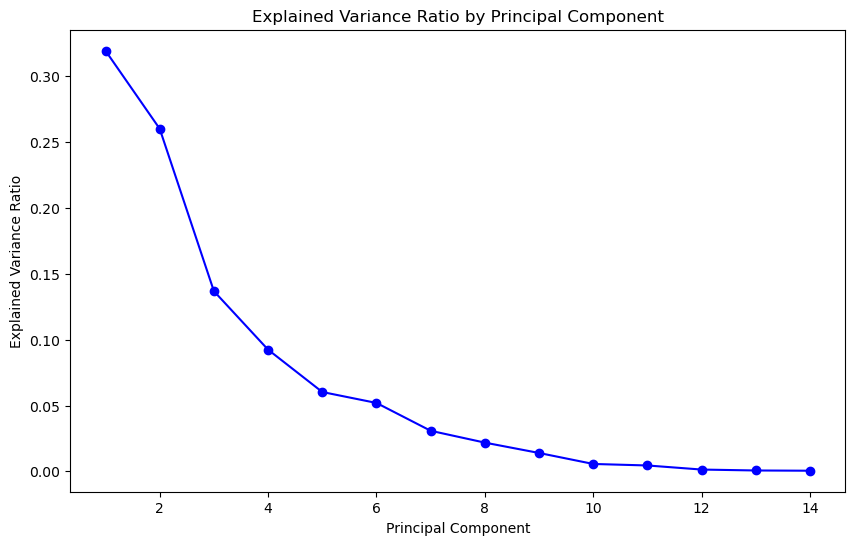

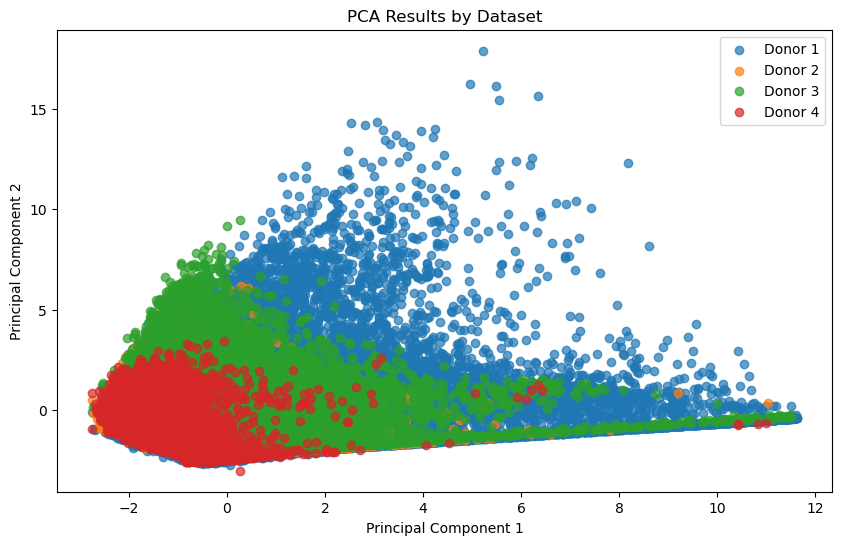

In [13]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, NUMBER_GAPS, NUMBER_COMPLEX from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding

# Perform UMAP on the pooled dataset
embedding = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Elbow plot to identify optimal number of clusters using KMeans
def plot_elbow_curve(data):
    distortions = []
    K = range(1, 11)
    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        distortions.append(kmeans.inertia_)
    
    plt.figure(figsize=(10, 6))
    plt.plot(K, distortions, 'bo-')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Distortion')
    plt.title('Elbow Method For Optimal k')
    plt.show()
    
    return distortions

# Plot elbow curve using the UMAP embedding data and determine optimal number of clusters
distortions = plot_elbow_curve(embedding)

# Determine the optimal number of clusters (k) from the elbow plot (manually identified here as an example)
optimal_k = 7

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Add cluster information to the embedding DataFrame
embedding_df['Cluster'] = clusters

# Plot full UMAP with color coding by KMeans clusters using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    subset = embedding_df[embedding_df['Cluster'] == i]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {i}', alpha=0.7)
plt.title(f'Full UMAP Clustering by KMeans Clusters (k={optimal_k})')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()

# Function to perform PCA on the pooled dataset and plot explained variance ratio
def perform_pca(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for PCA (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform PCA with a fixed random seed for reproducibility
    pca = PCA(random_state=42)
    pca_result = pca.fit_transform(scaled_data)
    
    # Create a DataFrame for PCA results
    pca_df = pd.DataFrame(pca_result, columns=[f'PC{i+1}' for i in range(pca_result.shape[1])])
    
    return pca, pca_df

# Perform PCA on the pooled dataset
pca, pca_df = perform_pca(pooled_df)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, 'bo-')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Principal Component')
plt.show()

# Plot PCA results with color coding by dataset
pca_df['Dataset'] = pooled_df['Dataset'].values

plt.figure(figsize=(10, 6))
for dataset in pca_df['Dataset'].unique():
    subset = pca_df[pca_df['Dataset'] == dataset]
    plt.scatter(subset['PC1'], subset['PC2'], label=dataset, alpha=0.7)
plt.title('PCA Results by Dataset')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()




c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


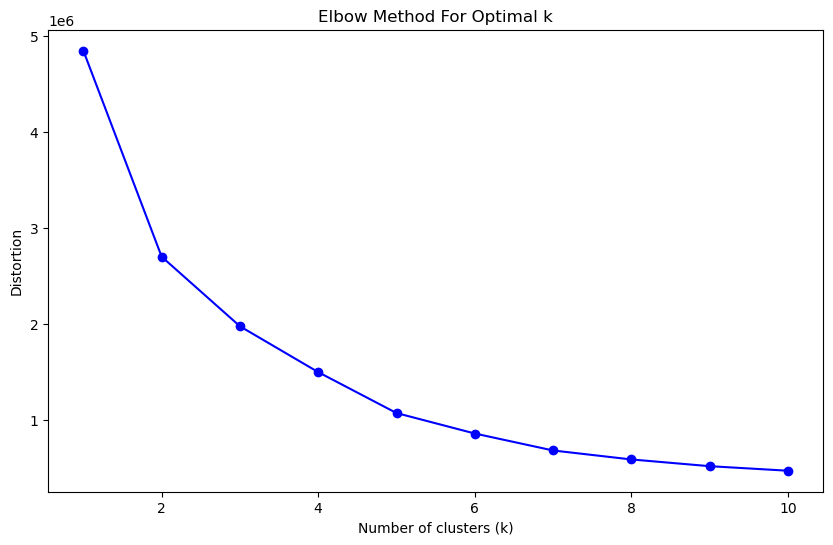

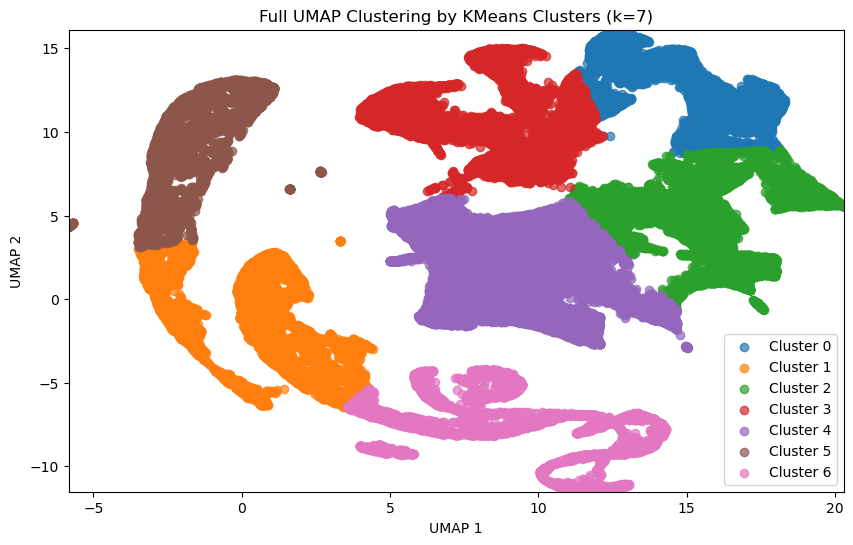

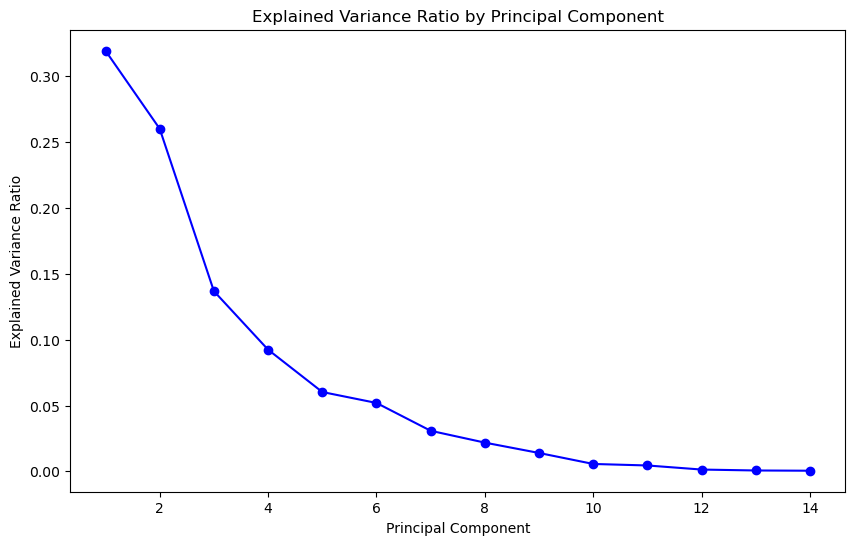

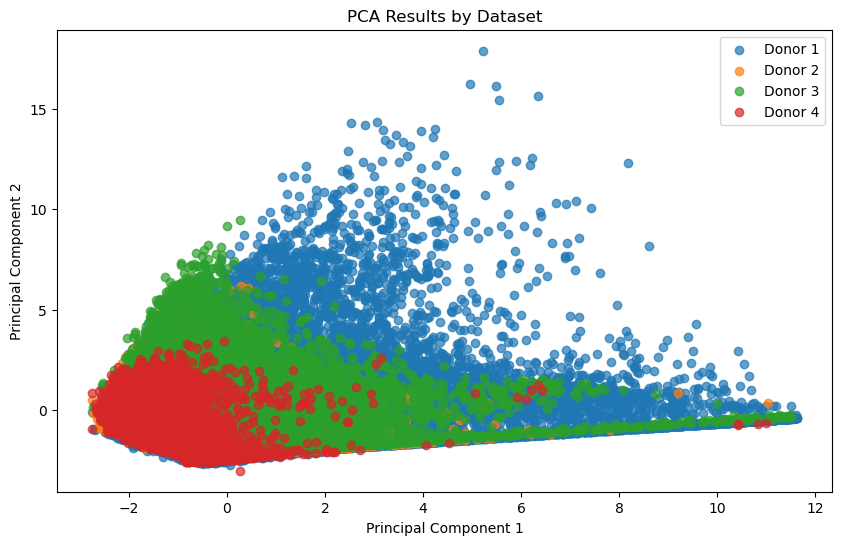

In [15]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import os
import umap
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, NUMBER_GAPS, NUMBER_COMPLEX from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding

# Perform UMAP on the pooled dataset
embedding = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Elbow plot to identify optimal number of clusters using KMeans
def plot_elbow_curve(data):
    distortions = []
    K = range(1, 11)
    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        distortions.append(kmeans.inertia_)
    
    plt.figure(figsize=(10, 6))
    plt.plot(K, distortions, 'bo-')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Distortion')
    plt.title('Elbow Method For Optimal k')
    plt.show()
    
    return distortions

# Plot elbow curve using the UMAP embedding data and determine optimal number of clusters
distortions = plot_elbow_curve(embedding)

# Determine the optimal number of clusters (k) from the elbow plot (manually identified here as an example)
optimal_k = 7

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Add cluster information to the embedding DataFrame
embedding_df['Cluster'] = clusters

# Plot full UMAP with color coding by KMeans clusters using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    subset = embedding_df[embedding_df['Cluster'] == i]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {i}', alpha=0.7)
plt.title(f'Full UMAP Clustering by KMeans Clusters (k={optimal_k})')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()

# Function to perform PCA on the pooled dataset and plot explained variance ratio
def perform_pca(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for PCA (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform PCA with a fixed random seed for reproducibility
    pca = PCA(random_state=42)
    pca_result = pca.fit_transform(scaled_data)
    
    # Create a DataFrame for PCA results
    pca_df = pd.DataFrame(pca_result, columns=[f'PC{i+1}' for i in range(pca_result.shape[1])])
    
    return pca, pca_df

# Perform PCA on the pooled dataset
pca, pca_df = perform_pca(pooled_df)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, 'bo-')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Principal Component')
plt.show()

# Plot PCA results with color coding by dataset in 2D
pca_df['Dataset'] = pooled_df['Dataset'].values

plt.figure(figsize=(10, 6))
for dataset in pca_df['Dataset'].unique():
    subset = pca_df[pca_df['Dataset'] == dataset]
    plt.scatter(subset['PC1'], subset['PC2'], label=dataset, alpha=0.7)
plt.title('PCA Results by Dataset')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

# Plot PCA results with color coding by dataset in 3D to include the third principal component and make it interactive and able to be rotated
fig = px.scatter_3d(pca_df, x='PC1', y='PC2', z='PC3', color='Dataset', title='3D PCA Results by Dataset')
fig.update_layout(scene = dict(
                    xaxis_title='Principal Component 1',
                    yaxis_title='Principal Component 2',
                    zaxis_title='Principal Component 3'))
fig.show()



Mapping parameter expression onto each cluster

c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



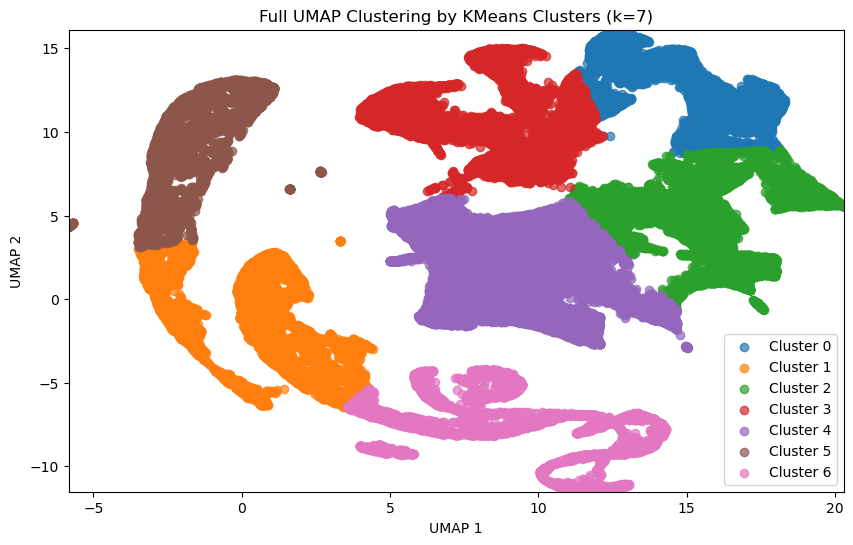

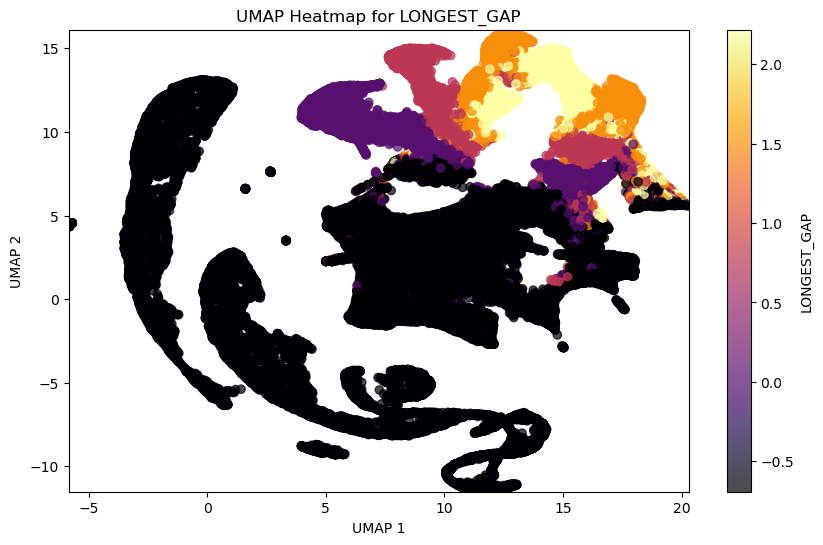

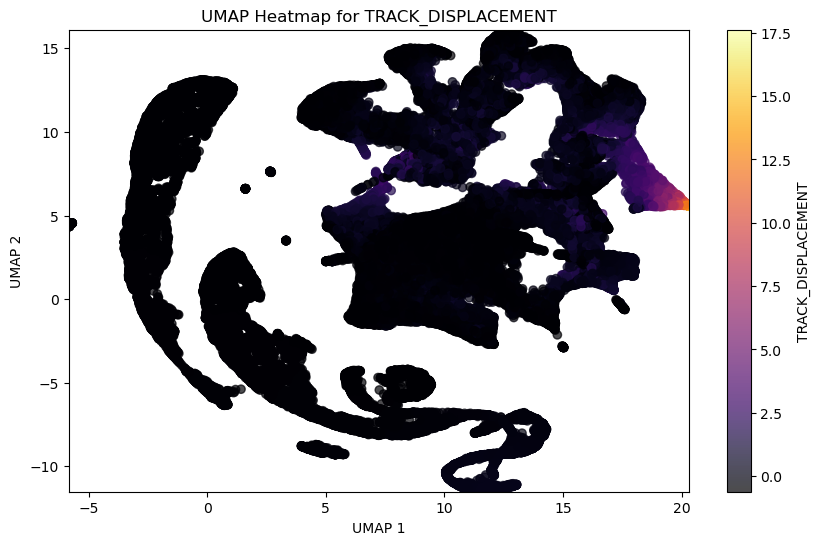

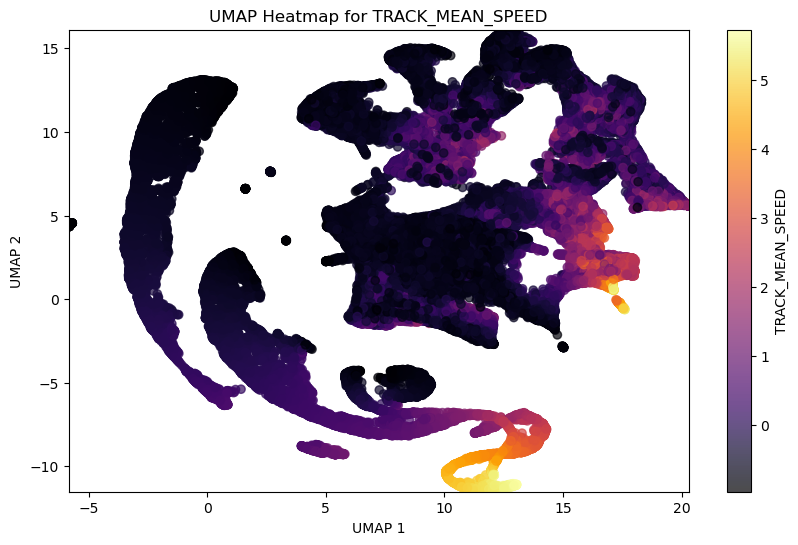

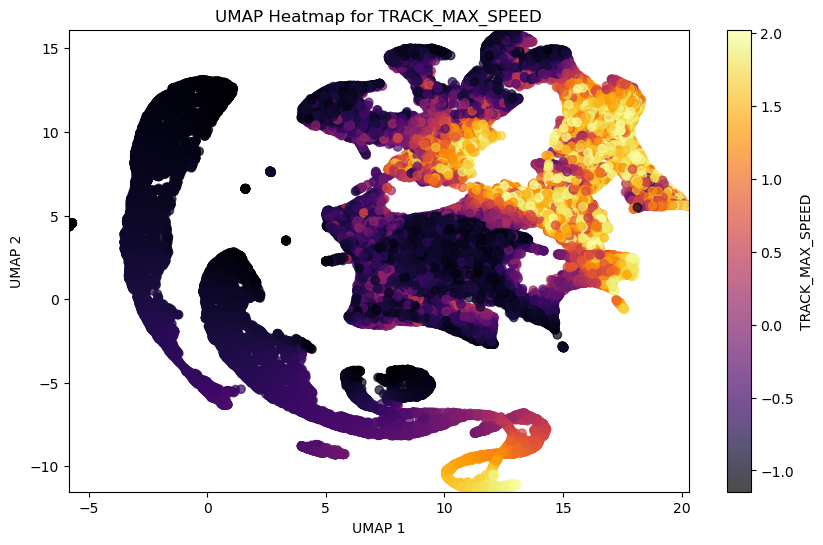

...

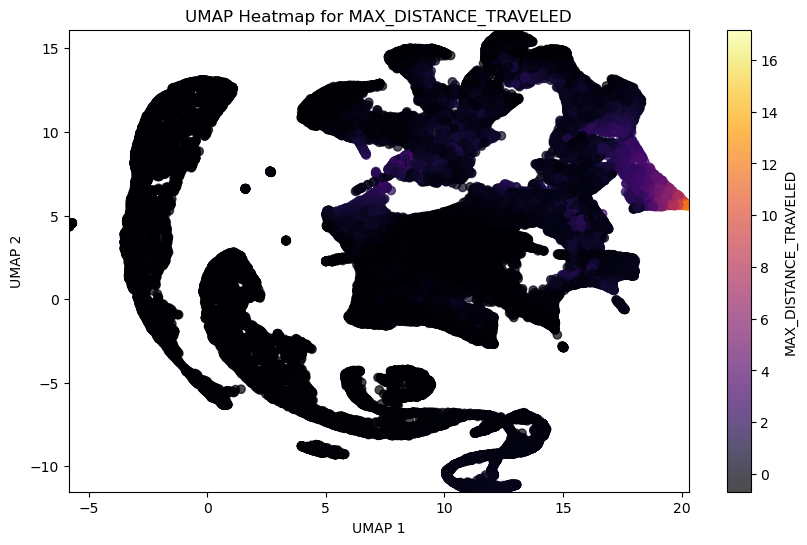

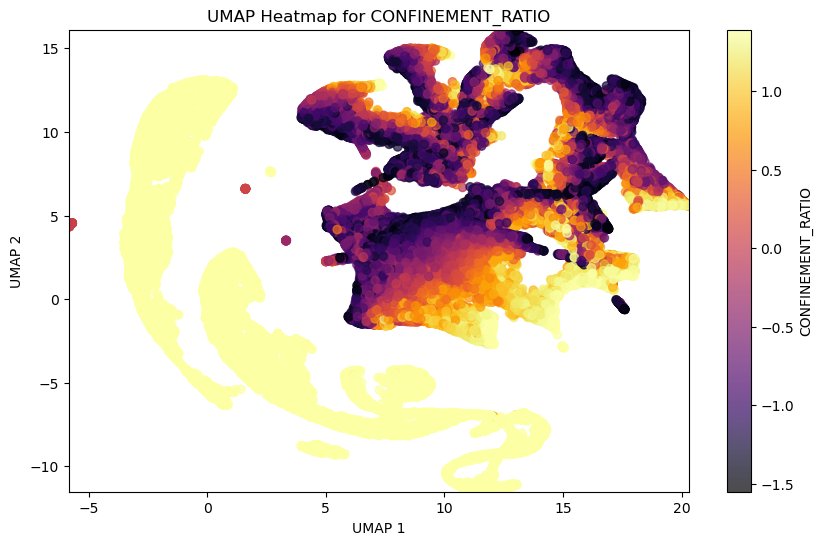

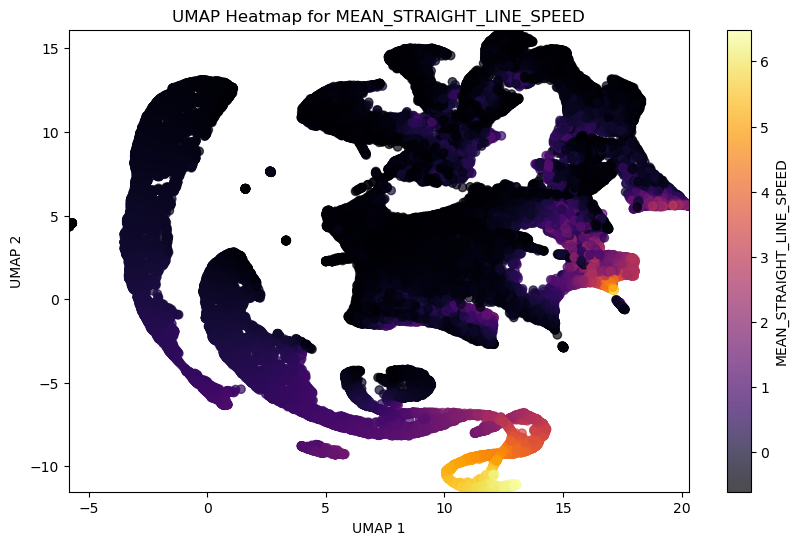

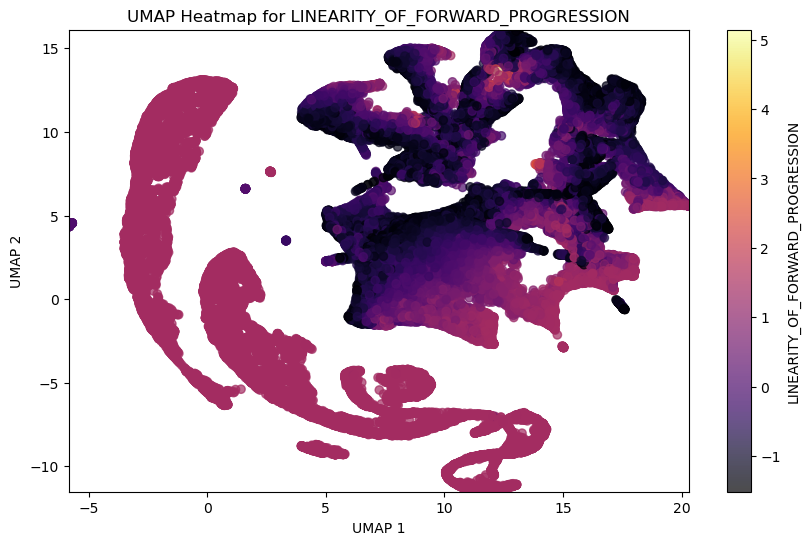

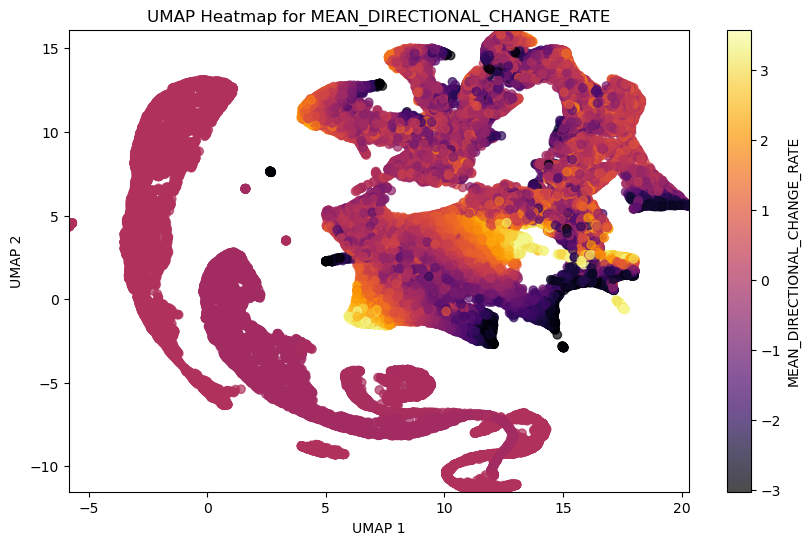

In [20]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import os
import umap
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, NUMBER_GAPS, NUMBER_COMPLEX from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding, scaled_data

# Perform UMAP on the pooled dataset
embedding, scaled_data = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Determine the optimal number of clusters (k) from the elbow plot (manually identified here as an example)
optimal_k = 7

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Add cluster information to the embedding DataFrame
embedding_df['Cluster'] = clusters

# Plot full UMAP with color coding by KMeans clusters using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    subset = embedding_df[embedding_df['Cluster'] == i]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {i}', alpha=0.7)
plt.title(f'Full UMAP Clustering by KMeans Clusters (k={optimal_k})')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()

# Plot UMAP heatmaps for each parameter in each cluster identified by KMeans
numeric_cols = pooled_df.columns[3:-1]  # Select only numeric columns for heatmap (skip the first three non-numeric columns and the last column indicating dataset)

for col in numeric_cols:
    plt.figure(figsize=(10, 6))
    plt.scatter(embedding_df['UMAP 1'], embedding_df['UMAP 2'], c=scaled_data[:, numeric_cols.get_loc(col)], cmap='inferno', alpha=0.7)
    plt.colorbar(label=col)
    plt.title(f'UMAP Heatmap for {col}')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


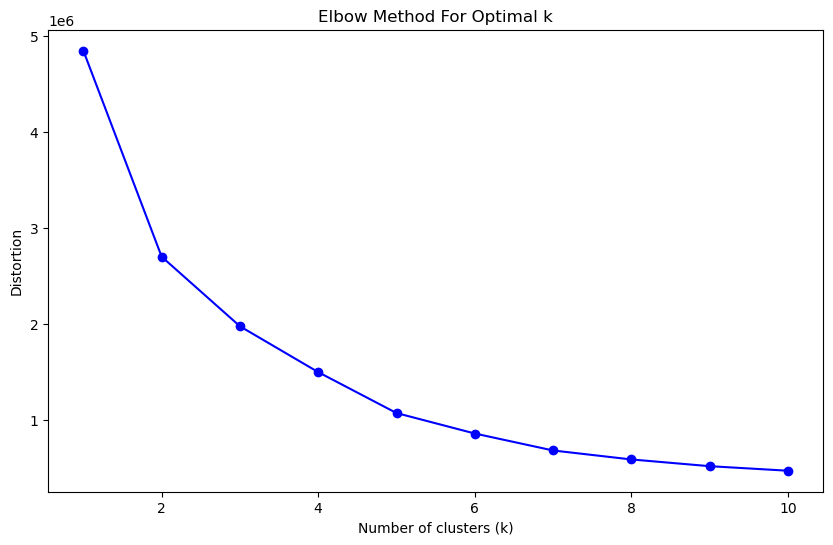

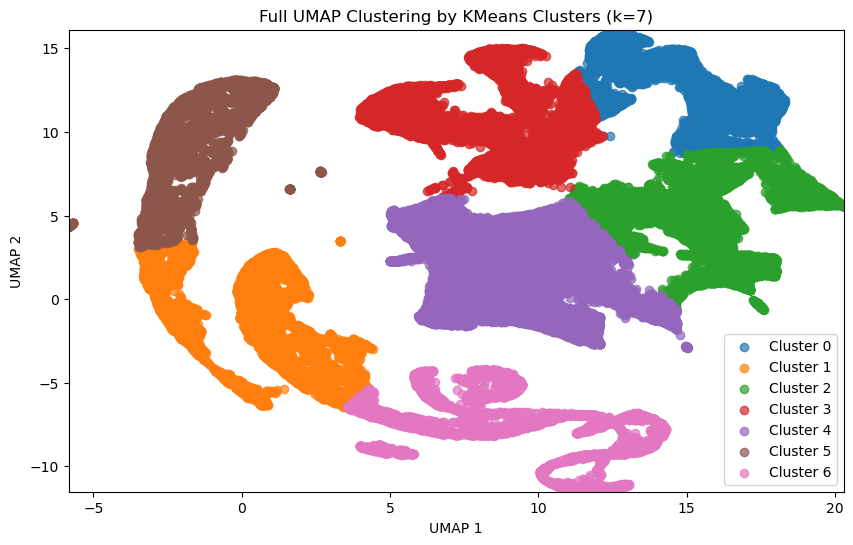

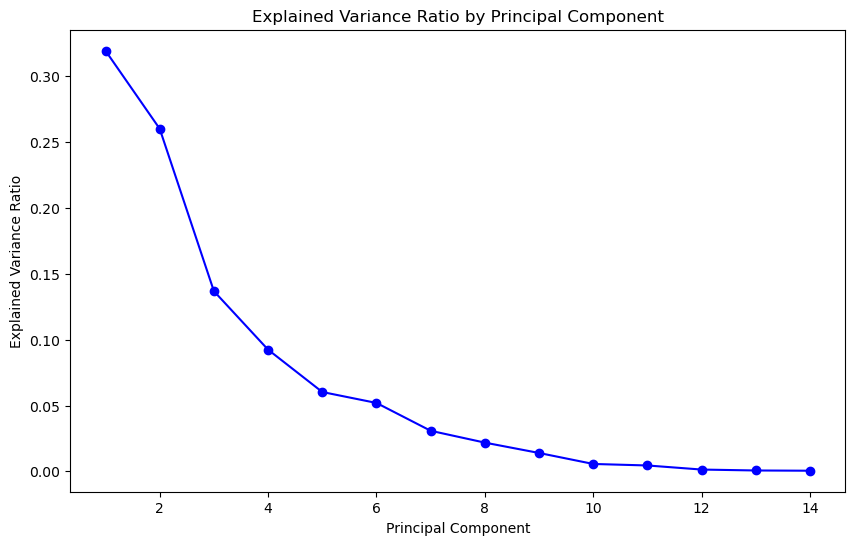

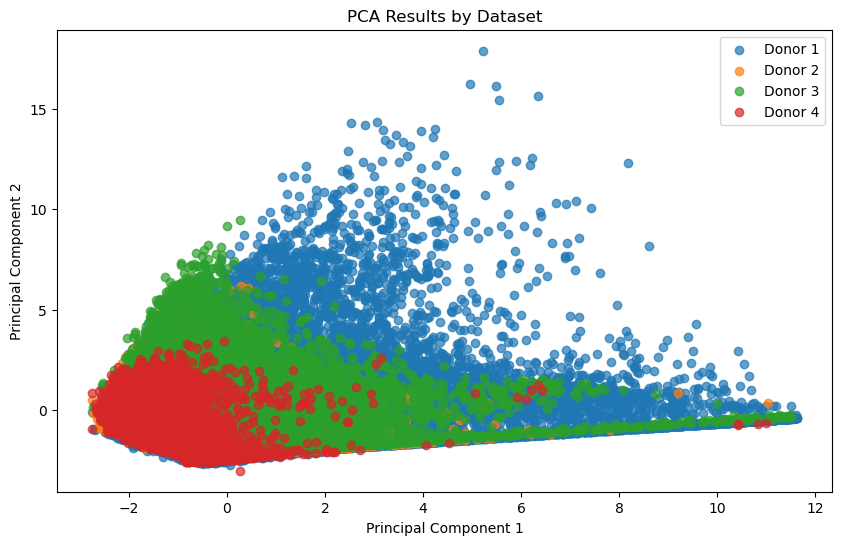

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, NUMBER_GAPS, NUMBER_COMPLEX from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding

# Perform UMAP on the pooled dataset
embedding = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Elbow plot to identify optimal number of clusters using KMeans
def plot_elbow_curve(data):
    distortions = []
    K = range(1, 11)
    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        distortions.append(kmeans.inertia_)
    
    plt.figure(figsize=(10, 6))
    plt.plot(K, distortions, 'bo-')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Distortion')
    plt.title('Elbow Method For Optimal k')
    plt.show()
    
    return distortions

# Plot elbow curve using the UMAP embedding data and determine optimal number of clusters
distortions = plot_elbow_curve(embedding)

# Determine the optimal number of clusters (k) from the elbow plot (manually identified here as an example)
optimal_k = 7

# Perform KMeans clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
clusters = kmeans.fit_predict(embedding)

# Add cluster information to the embedding DataFrame
embedding_df['Cluster'] = clusters

# Plot full UMAP with color coding by KMeans clusters using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
for i in range(optimal_k):
    subset = embedding_df[embedding_df['Cluster'] == i]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {i}', alpha=0.7)
plt.title(f'Full UMAP Clustering by KMeans Clusters (k={optimal_k})')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()

# Function to perform PCA on the pooled dataset and plot explained variance ratio
def perform_pca(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for PCA (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform PCA with a fixed random seed for reproducibility
    pca = PCA(random_state=42)
    pca_result = pca.fit_transform(scaled_data)
    
    # Create a DataFrame for PCA results
    pca_df = pd.DataFrame(pca_result, columns=[f'PC{i+1}' for i in range(pca_result.shape[1])])
    
    return pca, pca_df

# Perform PCA on the pooled dataset
pca, pca_df = perform_pca(pooled_df)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, 'bo-')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Principal Component')
plt.show()

# Plot PCA results with color coding by dataset
pca_df['Dataset'] = pooled_df['Dataset'].values

plt.figure(figsize=(10, 6))
for dataset in pca_df['Dataset'].unique():
    subset = pca_df[pca_df['Dataset'] == dataset]
    plt.scatter(subset['PC1'], subset['PC2'], label=dataset, alpha=0.7)
plt.title('PCA Results by Dataset')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()




c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


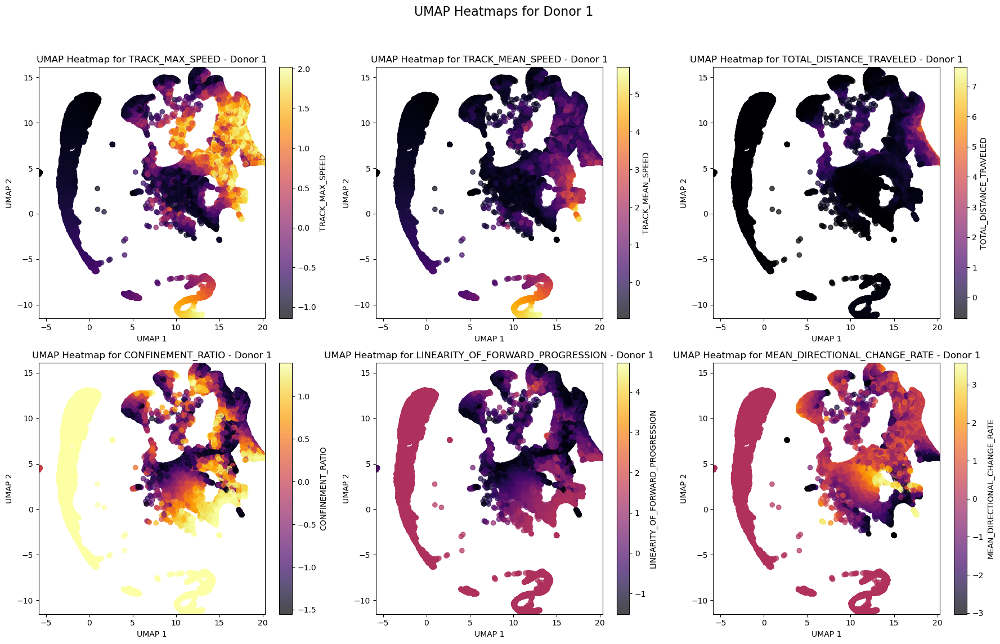

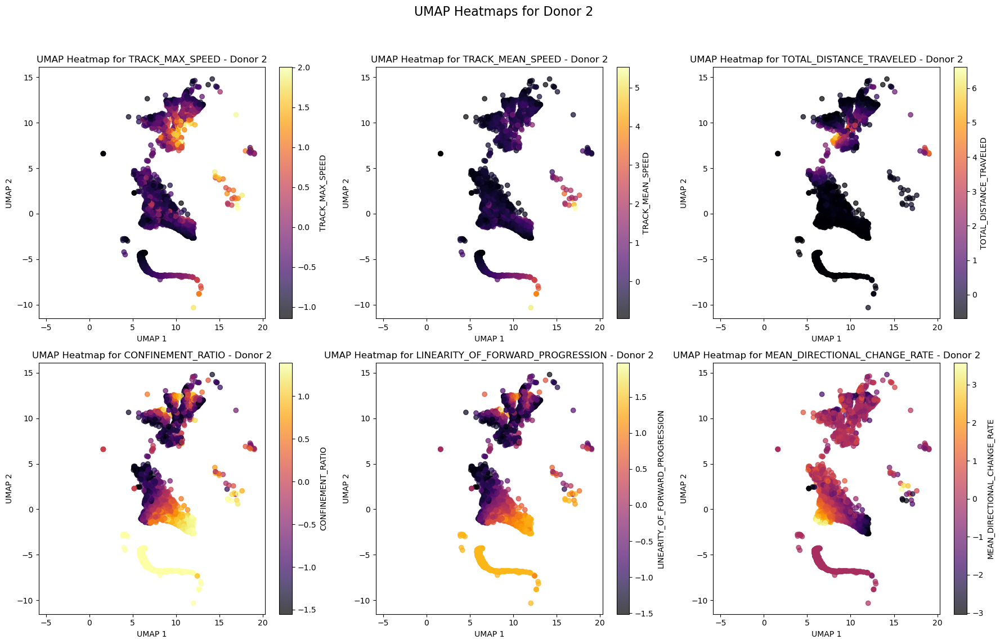

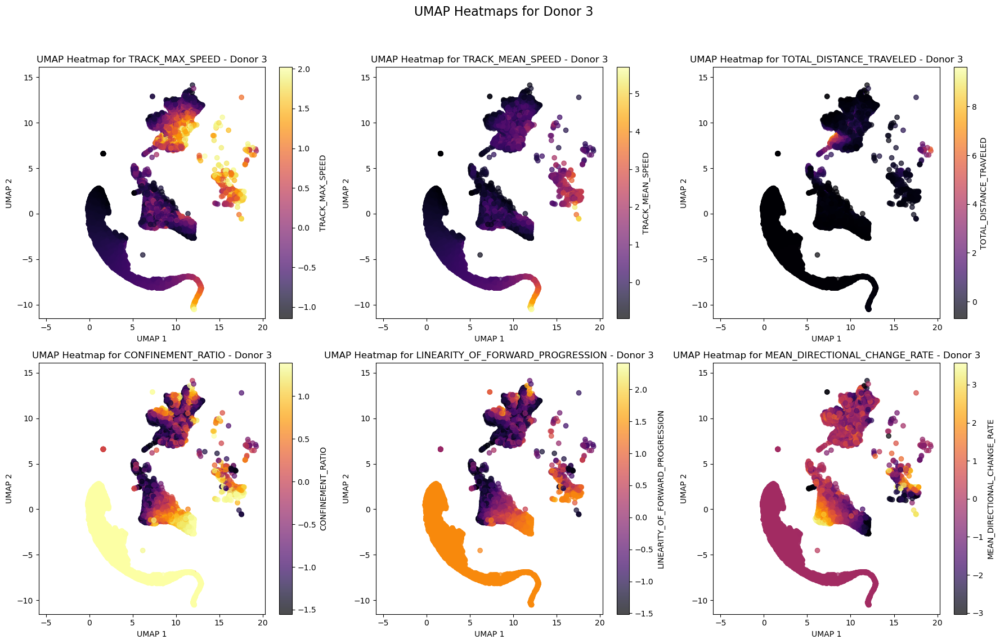

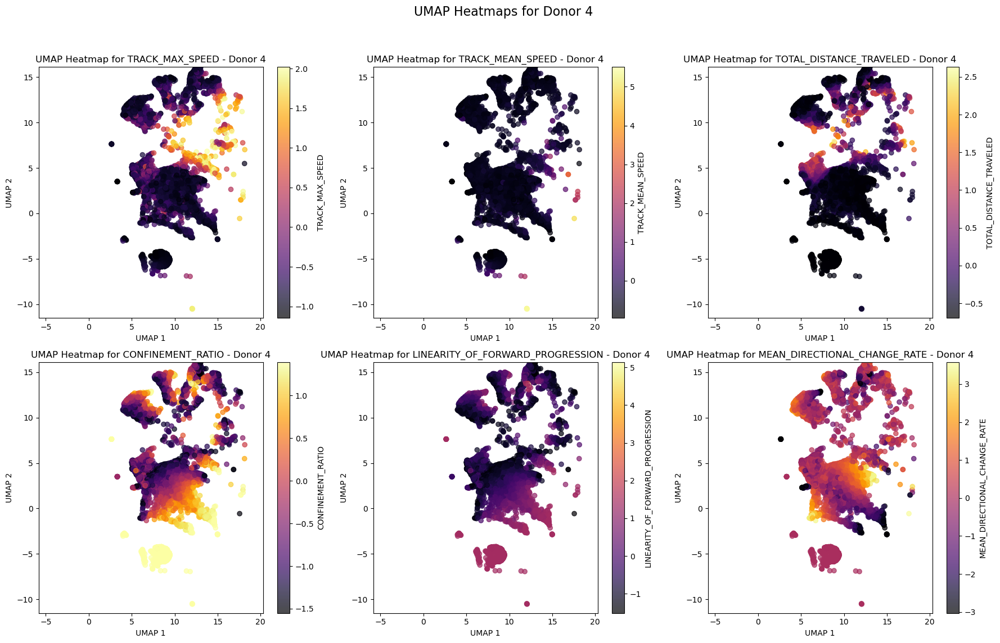

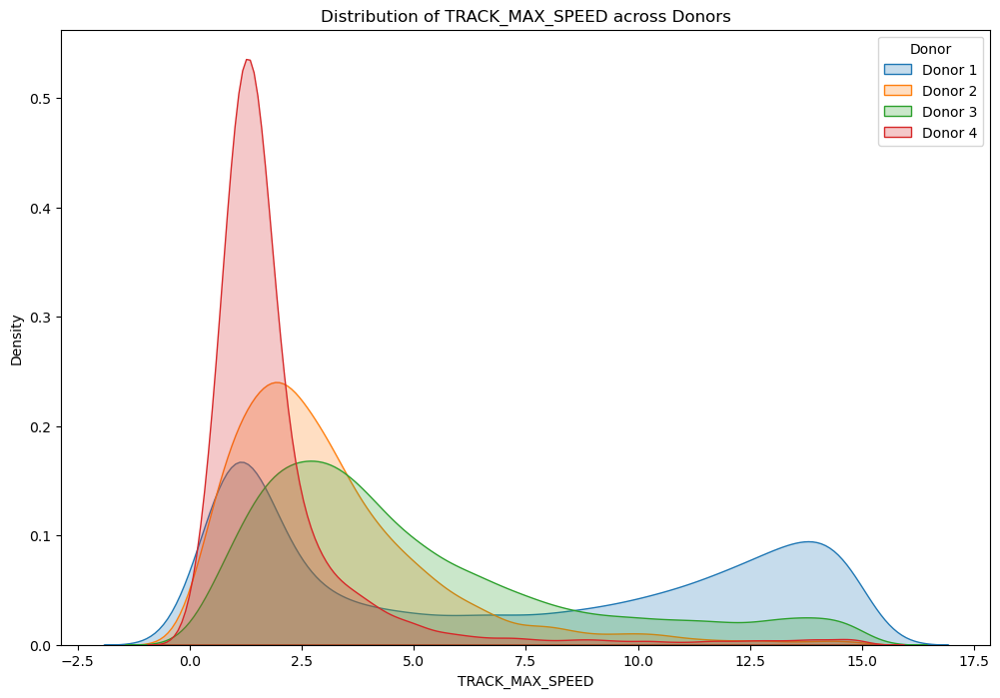

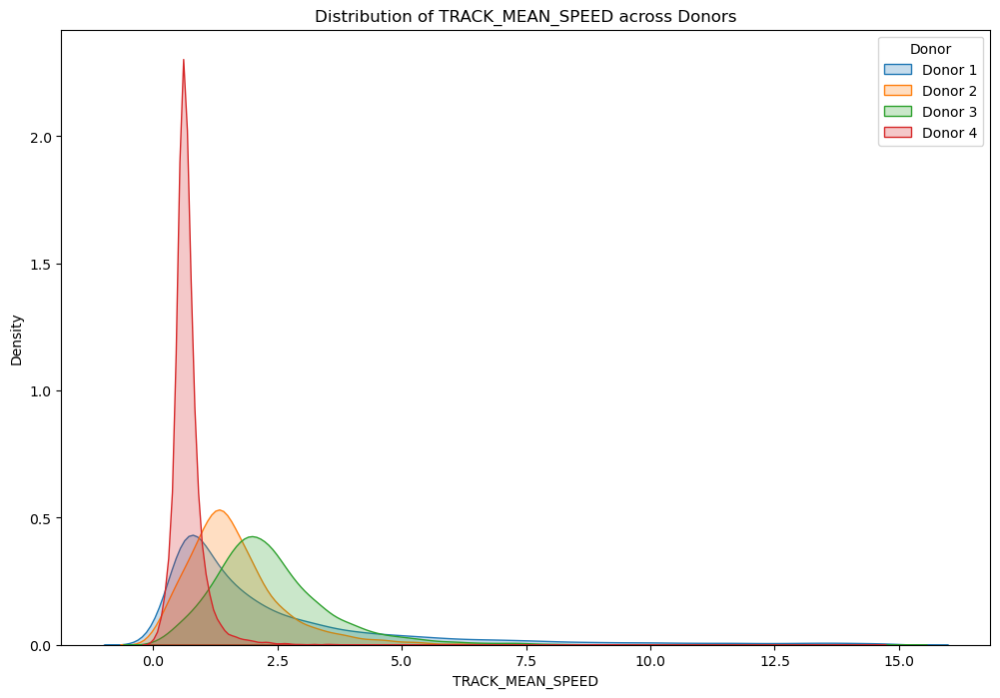

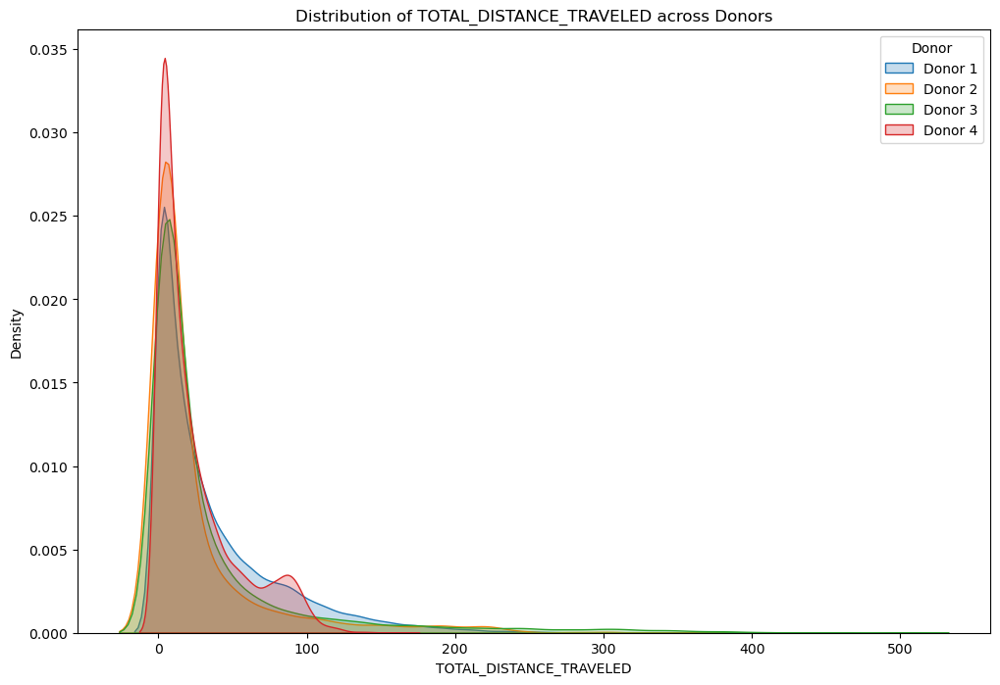

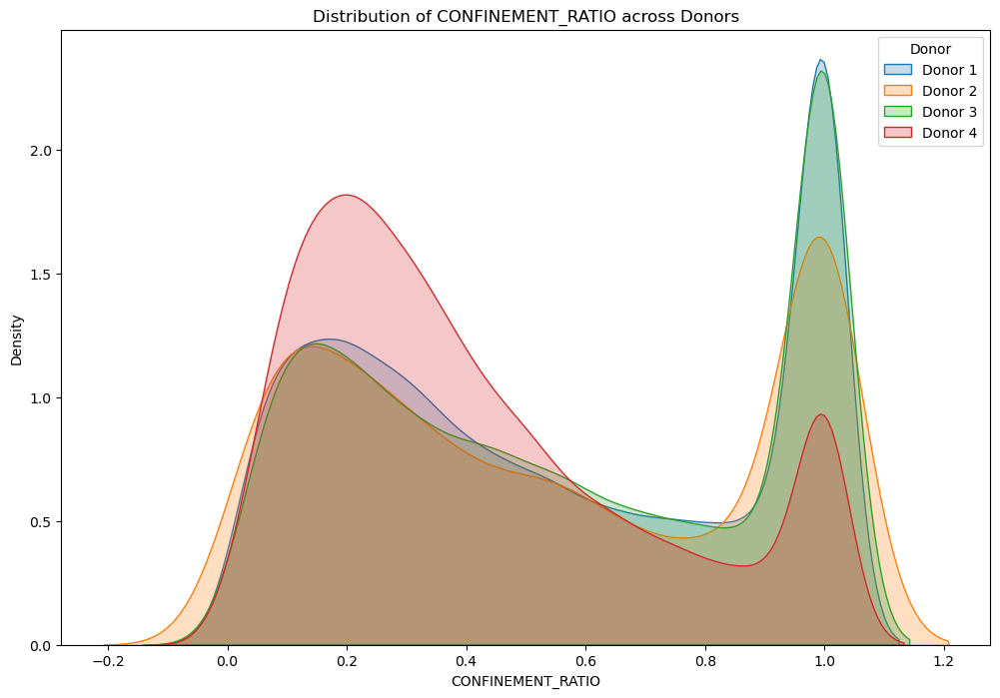

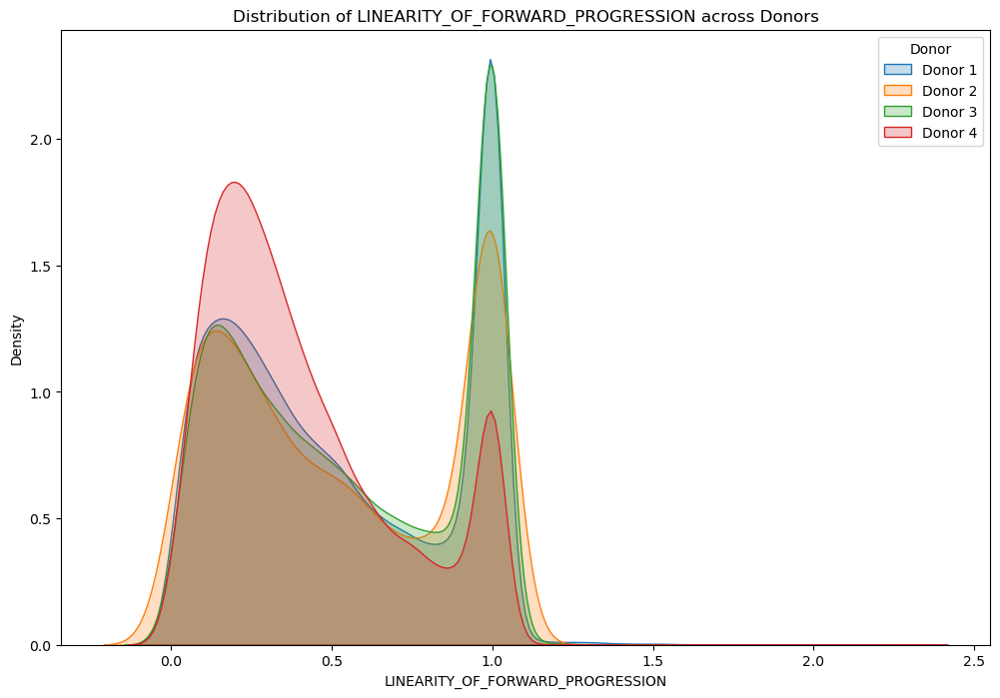

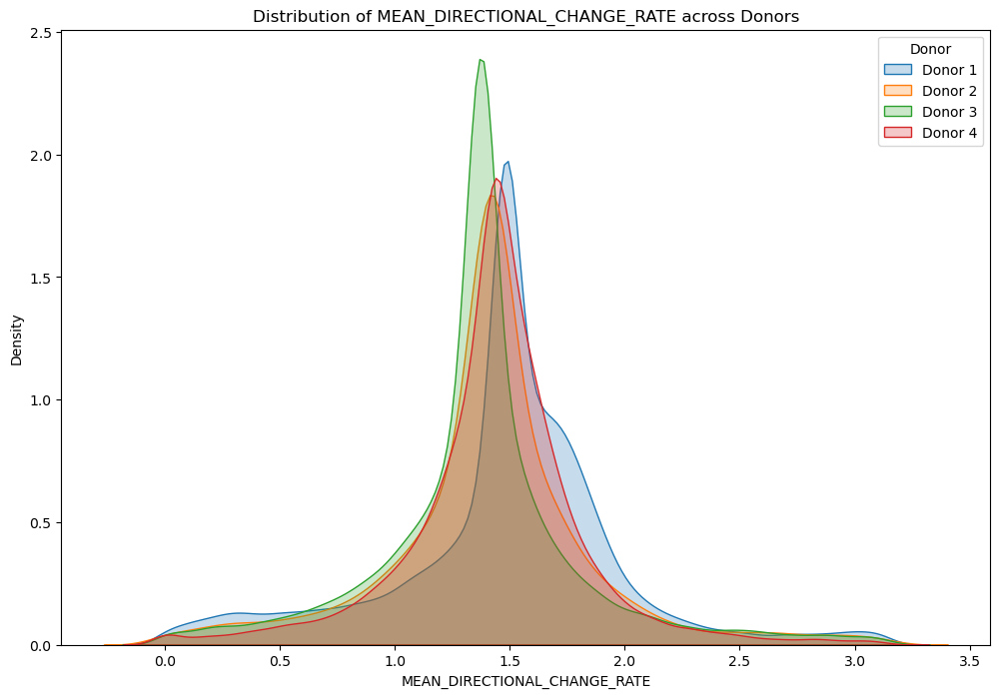

In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import umap
import seaborn as sns


# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns not needed for the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding, scaled_data

# Perform UMAP on the pooled dataset
embedding, scaled_data = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# List of specific parameters to display heatmaps for
parameters_to_display = ['TRACK_MAX_SPEED', 'TRACK_MEAN_SPEED', 'TOTAL_DISTANCE_TRAVELED', 'CONFINEMENT_RATIO', 'LINEARITY_OF_FORWARD_PROGRESSION', 'MEAN_DIRECTIONAL_CHANGE_RATE']

# Plot UMAP heatmaps for each specified parameter in each cluster identified by KMeans for each individual donor using inferno colormap and compile them into a single plot per donor
for donor in pooled_df['Dataset'].unique():
    donor_embedding_df = embedding_df[embedding_df['Dataset'] == donor]
    donor_scaled_data = scaled_data[embedding_df['Dataset'] == donor]
    
    num_cols = len(parameters_to_display)
    num_rows = (num_cols + 2) // 3
    
    fig, axes = plt.subplots(num_rows, 3, figsize=(18, num_rows * 6))
    axes = axes.flatten()
    
    for i, col in enumerate(parameters_to_display):
        ax = axes[i]
        sc = ax.scatter(donor_embedding_df['UMAP 1'], donor_embedding_df['UMAP 2'], c=donor_scaled_data[:, pooled_df.columns.get_loc(col) - 3], cmap='inferno', alpha=0.7)
        fig.colorbar(sc, ax=ax, label=col)
        ax.set_title(f'UMAP Heatmap for {col} - {donor}')
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
    
    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle(f'UMAP Heatmaps for {donor}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Additional code to create plots showing the distribution of parameter expression in the four donors

# Plot distribution of each parameter for each donor
for col in parameters_to_display:
    plt.figure(figsize=(12, 8))
    
    for donor in pooled_df['Dataset'].unique():
        subset = pooled_df[pooled_df['Dataset'] == donor]
        sns.kdeplot(subset[col], label=donor, fill=True)
    
    plt.title(f'Distribution of {col} across Donors')
    plt.xlabel(col)
    plt.ylabel('Density')
    plt.legend(title='Donor')
    plt.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


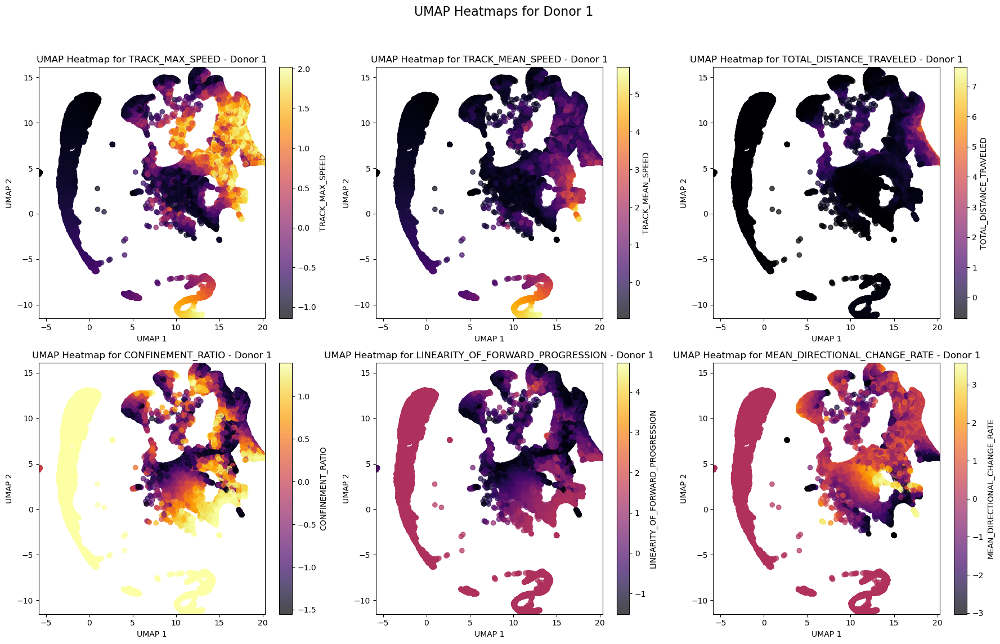

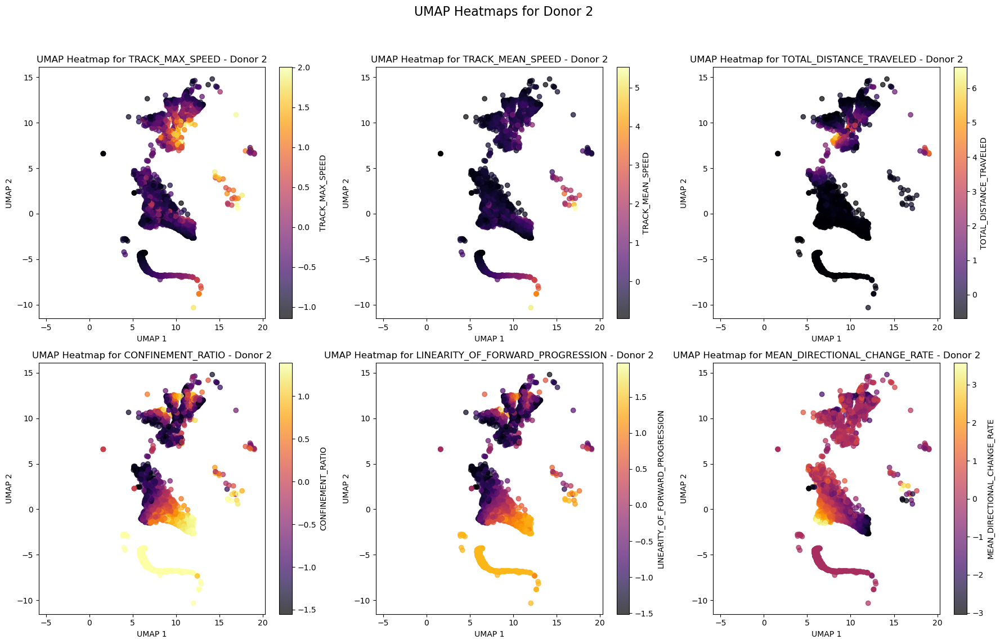

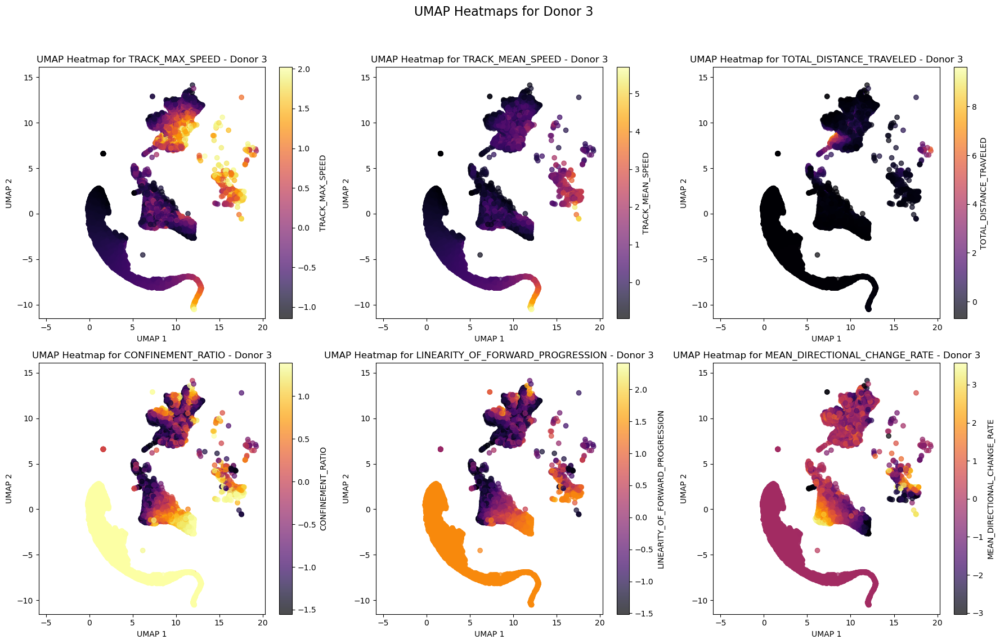

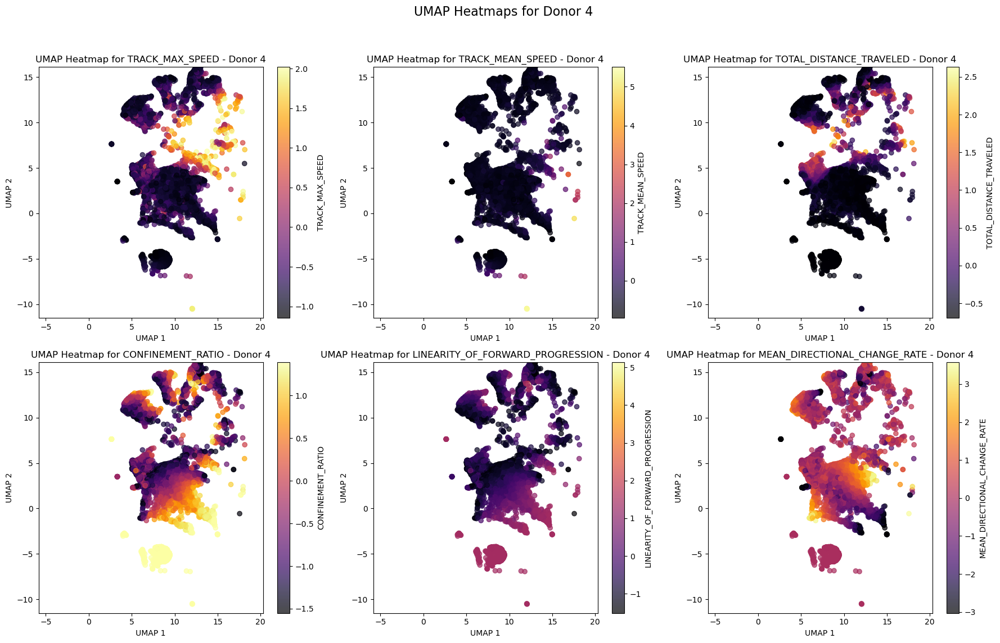

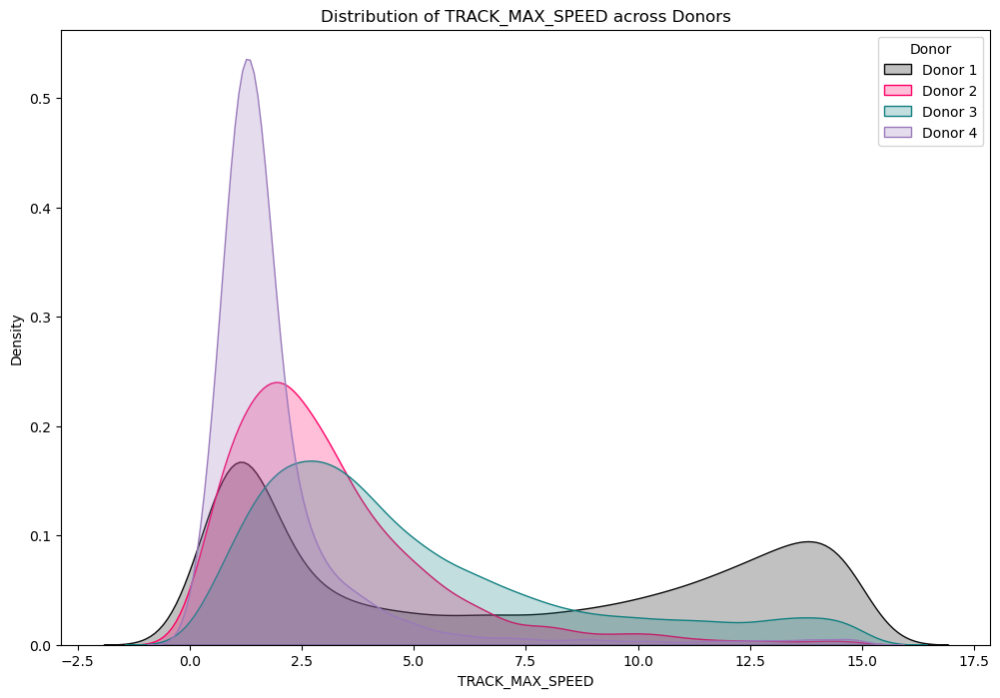

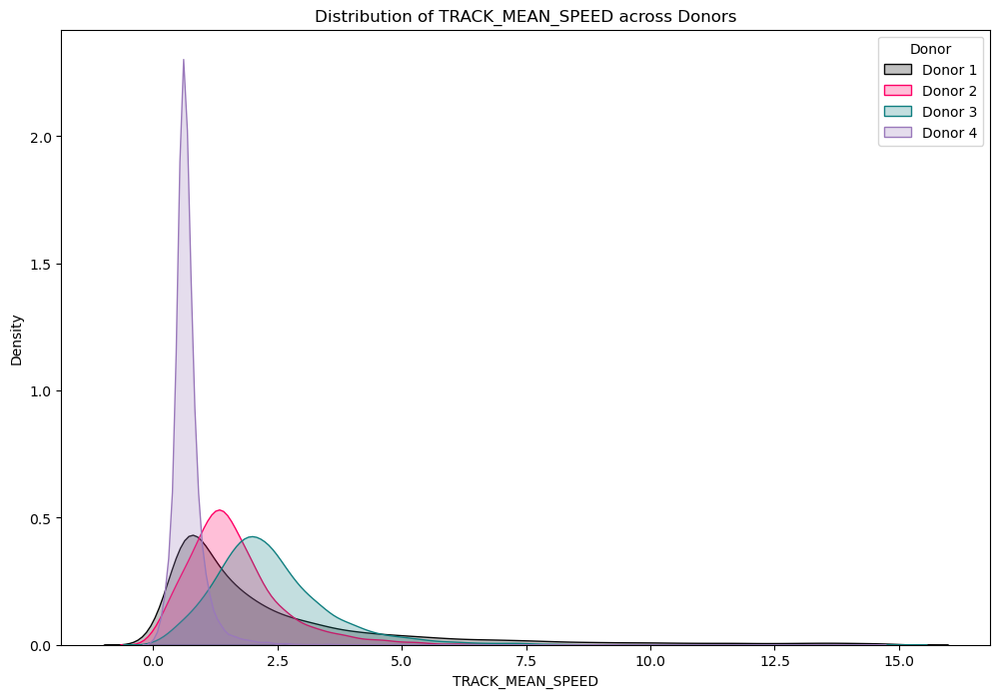

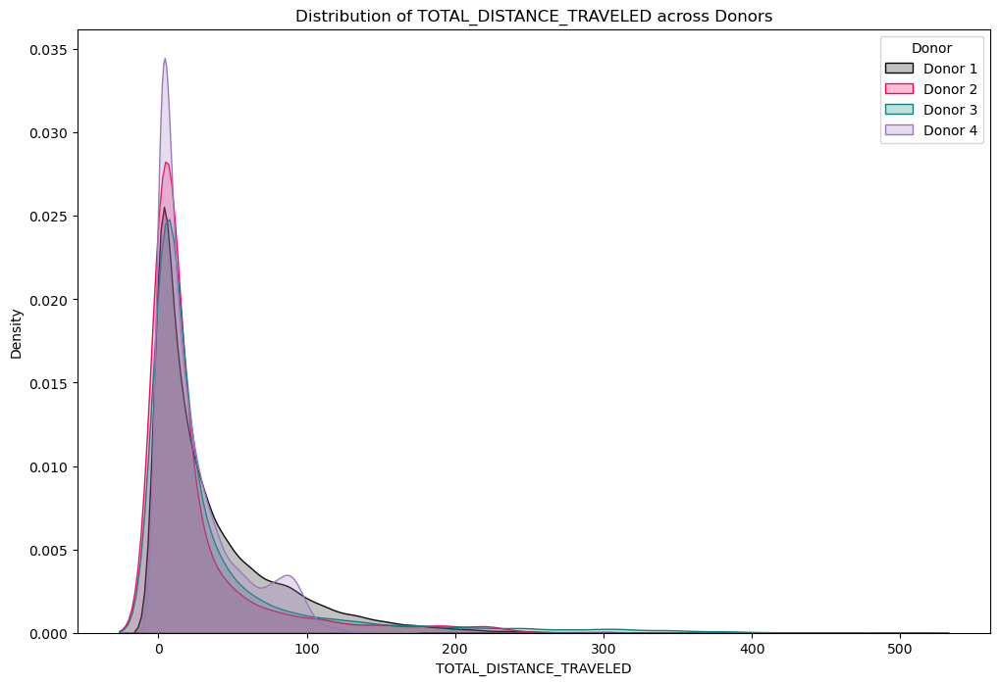

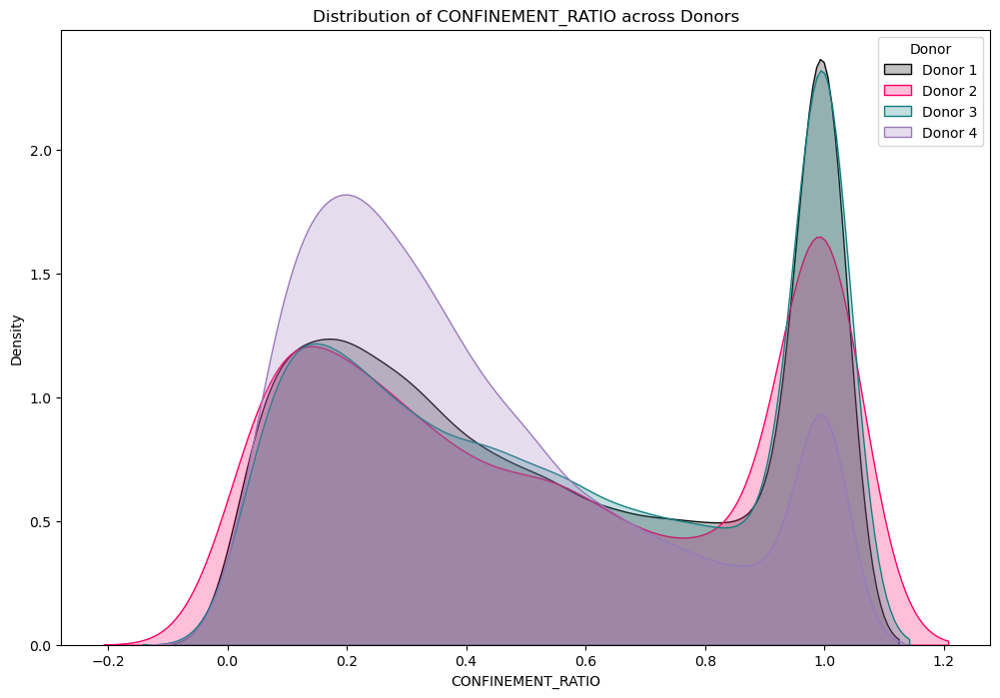

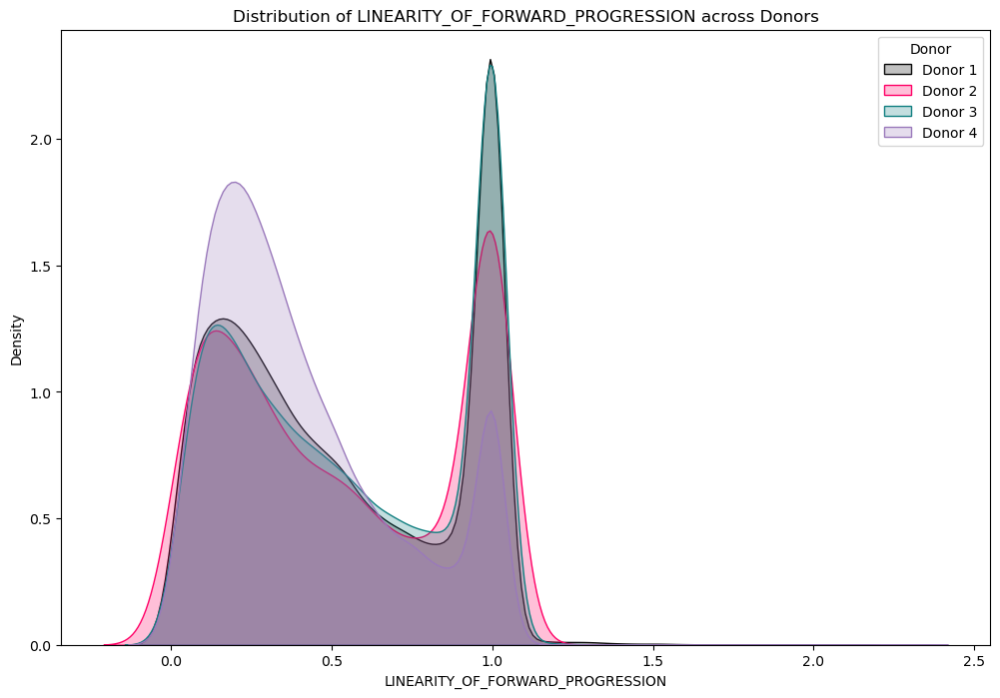

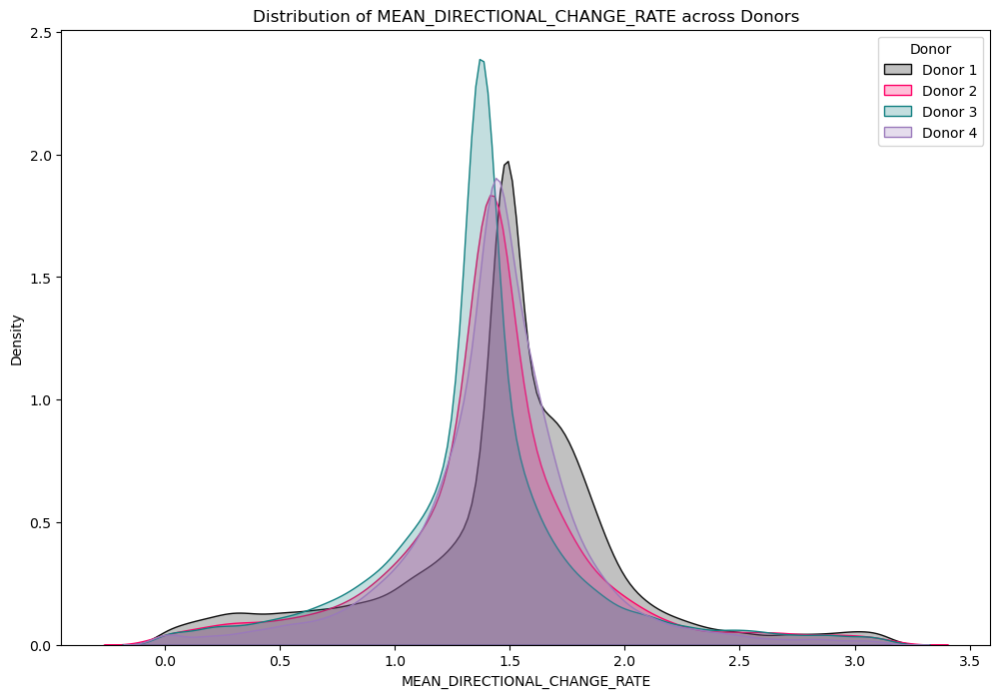

In [15]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns not needed for the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding, scaled_data

# Perform UMAP on the pooled dataset
embedding, scaled_data = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# List of specific parameters to display heatmaps for
parameters_to_display = ['TRACK_MAX_SPEED', 'TRACK_MEAN_SPEED', 'TOTAL_DISTANCE_TRAVELED', 'CONFINEMENT_RATIO', 'LINEARITY_OF_FORWARD_PROGRESSION', 'MEAN_DIRECTIONAL_CHANGE_RATE']

# Plot UMAP heatmaps for each specified parameter in each cluster identified by KMeans for each individual donor using inferno colormap and compile them into a single plot per donor
for donor in pooled_df['Dataset'].unique():
    donor_embedding_df = embedding_df[embedding_df['Dataset'] == donor]
    donor_scaled_data = scaled_data[embedding_df['Dataset'] == donor]
    
    num_cols = len(parameters_to_display)
    num_rows = (num_cols + 2) // 3
    
    fig, axes = plt.subplots(num_rows, 3, figsize=(18, num_rows * 6))
    axes = axes.flatten()
    
    for i, col in enumerate(parameters_to_display):
        ax = axes[i]
        sc = ax.scatter(donor_embedding_df['UMAP 1'], donor_embedding_df['UMAP 2'], c=donor_scaled_data[:, pooled_df.columns.get_loc(col) - 3], cmap='inferno', alpha=0.7)
        fig.colorbar(sc, ax=ax, label=col)
        ax.set_title(f'UMAP Heatmap for {col} - {donor}')
        ax.set_xlabel('UMAP 1')
        ax.set_ylabel('UMAP 2')
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
    
    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle(f'UMAP Heatmaps for {donor}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Additional code to create plots showing the distribution of parameter expression in the four donors

# Define RGB colors for each donor
donor_colors = {
    'Donor 1': (9, 9, 9),  # Black
    'Donor 2': (255, 0, 102),  # Pink
    'Donor 3': (16, 127, 128),  # Green
    'Donor 4': (154, 121, 187)   # Purple
}

# Normalize RGB values to the range 0-1
donor_colors = {k: tuple(np.array(v) / 255) for k, v in donor_colors.items()}

# Plot distribution of each parameter for each donor with specified RGB colors
for col in parameters_to_display:
    plt.figure(figsize=(12, 8))
    
    for donor in pooled_df['Dataset'].unique():
        subset = pooled_df[pooled_df['Dataset'] == donor]
        sns.kdeplot(subset[col], label=donor, fill=True, color=donor_colors[donor])
    
    plt.title(f'Distribution of {col} across Donors')
    plt.xlabel(col)
    plt.ylabel('Density')
    plt.legend(title='Donor')
    plt.show()

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import os
import umap
import plotly.express as px

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns TRACK_X_LOCATION, TRACK_Y_LOCATION, TRACK_STOP, TRACK_START, TRACK_DURATION, TRACK_Z_LOCATION, NUMBER_MERGES, NUMBER_SPLITS, NUMBER_SPOTS, 
# NUMBER_GAPS, NUMBER_COMPLEX from the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 
                                    'NUMBER_SPLITS', 'NUMBER_SPOTS', 'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding

# Perform UMAP on the pooled dataset
embedding = perform_umap(pooled_df)

# Create a DataFrame for the embedding and add dataset information
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Create an interactive UMAP plot using Plotly Express
fig = px.scatter(embedding_df, x='UMAP 1', y='UMAP 2', color='Dataset', title='Interactive UMAP Clustering by Dataset - Pooled Datasets')

# Save the interactive plot as an HTML file
fig.write_html("interactive_umap.html")

print("The interactive UMAP plot has been saved as interactive_umap.html and can be sent as an email attachment.")


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


The interactive UMAP plot has been saved as interactive_umap.html and can be sent as an email attachment.


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


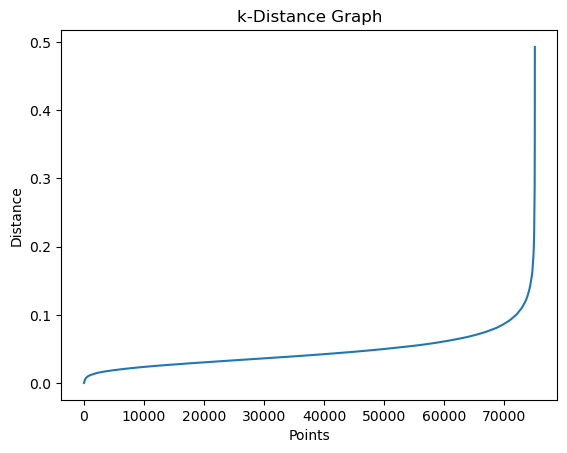

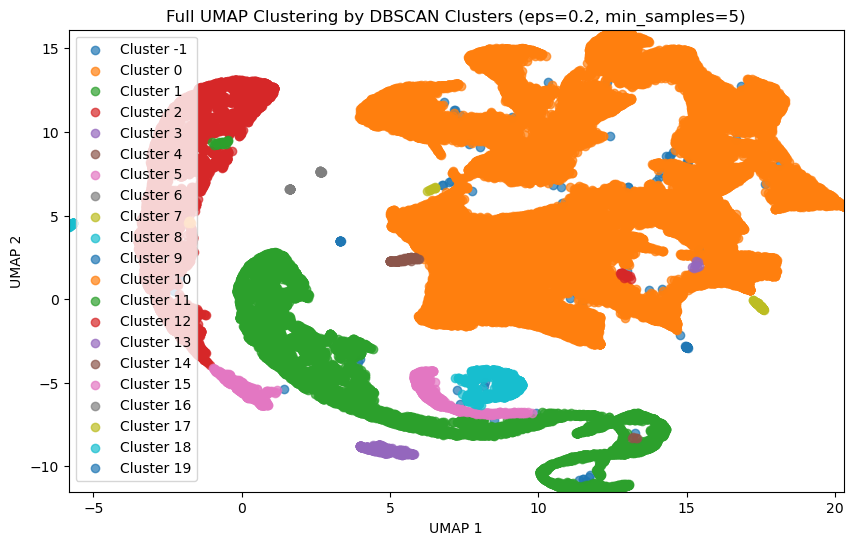

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns not needed for the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding, scaled_data

# Perform UMAP on the pooled dataset
embedding, scaled_data = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Optimize DBSCAN parameters using k-distance graph
def optimize_dbscan_params(data):
    neighbors = NearestNeighbors(n_neighbors=5)
    neighbors_fit = neighbors.fit(data)
    distances, indices = neighbors_fit.kneighbors(data)
    
    # Sort distances and plot k-distance graph
    distances = np.sort(distances[:, 4], axis=0)
    plt.plot(distances)
    plt.xlabel('Points')
    plt.ylabel('Distance')
    plt.title('k-Distance Graph')
    plt.show()
    
    # Manually identify epsilon from the elbow point in the graph (example value here)
    epsilon = 0.2
    
    # Set minimum samples (example value here)
    min_samples = 5
    
    return epsilon, min_samples

# Optimize DBSCAN parameters
epsilon, min_samples = optimize_dbscan_params(embedding)

# Perform DBSCAN clustering with optimized parameters
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
clusters = dbscan.fit_predict(embedding)

# Add cluster information to the embedding DataFrame
embedding_df['Cluster'] = clusters

# Plot full UMAP with color coding by DBSCAN clusters using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
unique_clusters = np.unique(clusters)
for cluster in unique_clusters:
    subset = embedding_df[embedding_df['Cluster'] == cluster]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {cluster}', alpha=0.7)
plt.title(f'Full UMAP Clustering by DBSCAN Clusters (eps={epsilon}, min_samples={min_samples})')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


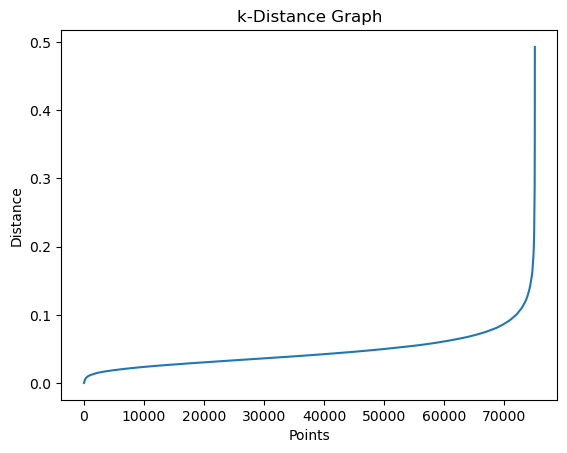

MinPts: 2, Silhouette Score: -0.1266452819108963
MinPts: 3, Silhouette Score: -0.1266452819108963
MinPts: 4, Silhouette Score: -0.1266452819108963
MinPts: 5, Silhouette Score: -0.1266452819108963
MinPts: 6, Silhouette Score: -0.1266452819108963
MinPts: 7, Silhouette Score: -0.1266452819108963
MinPts: 8, Silhouette Score: -0.1266452819108963
MinPts: 9, Silhouette Score: -0.1266452819108963
MinPts: 10, Silhouette Score: -0.1266452819108963
MinPts: 11, Silhouette Score: -0.1266452819108963
MinPts: 12, Silhouette Score: -0.1266452819108963
MinPts: 13, Silhouette Score: -0.13048051297664642
MinPts: 14, Silhouette Score: -0.13048051297664642
MinPts: 15, Silhouette Score: -0.13048051297664642
MinPts: 16, Silhouette Score: -0.13048051297664642
MinPts: 17, Silhouette Score: -0.13048051297664642
MinPts: 18, Silhouette Score: -0.13048051297664642
MinPts: 19, Silhouette Score: -0.13048051297664642
Optimal MinPts: 2


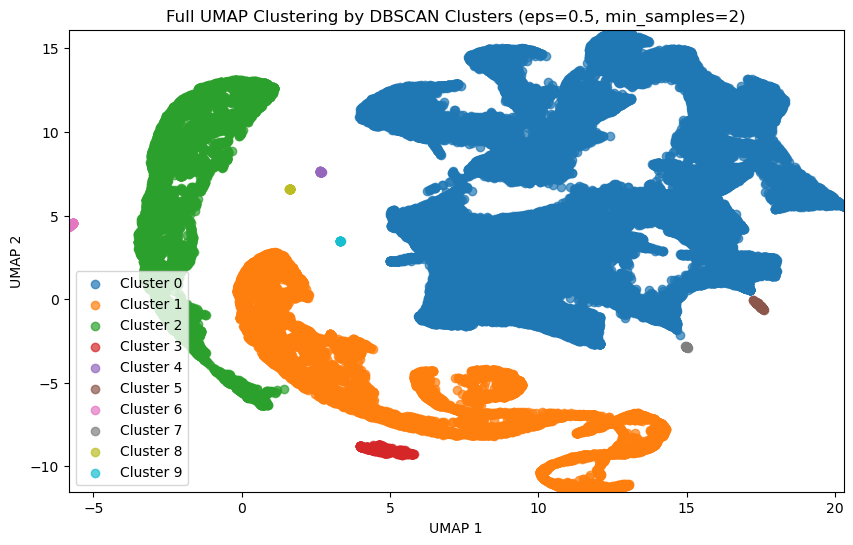

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns not needed for the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding, scaled_data

# Perform UMAP on the pooled dataset
embedding, scaled_data = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])

# Optimize DBSCAN parameters using k-distance graph
def plot_k_distance_graph(data):
    neighbors = NearestNeighbors(n_neighbors=5)
    neighbors_fit = neighbors.fit(data)
    distances, indices = neighbors_fit.kneighbors(data)
    
    # Sort distances and plot k-distance graph
    distances = np.sort(distances[:, 4], axis=0)
    plt.plot(distances)
    plt.xlabel('Points')
    plt.ylabel('Distance')
    plt.title('k-Distance Graph')
    plt.show()

# Plot k-distance graph for the UMAP embedding
plot_k_distance_graph(embedding)

# Function to evaluate DBSCAN with different MinPts values
def evaluate_dbscan_minpts(data, eps, minpts_values):
    best_score = -1
    best_minpts = None
    
    for minpts in minpts_values:
        dbscan = DBSCAN(eps=eps, min_samples=minpts)
        clusters = dbscan.fit_predict(data)
        
        # Calculate silhouette score if there are more than one cluster
        if len(set(clusters)) > 1:
            score = silhouette_score(data, clusters)
            print(f'MinPts: {minpts}, Silhouette Score: {score}')
            
            if score > best_score:
                best_score = score
                best_minpts = minpts
                
        else:
            print(f'MinPts: {minpts}, Only one cluster or noise detected')
    
    return best_minpts

# Example epsilon value (from k-distance graph)
epsilon = 0.5

# Range of MinPts values to test
minpts_values = range(2, 20)

# Evaluate DBSCAN with different MinPts values and find the best MinPts
best_minpts = evaluate_dbscan_minpts(embedding, epsilon, minpts_values)

print(f'Optimal MinPts: {best_minpts}')

# Perform DBSCAN clustering with optimized parameters
dbscan = DBSCAN(eps=epsilon, min_samples=best_minpts)
clusters = dbscan.fit_predict(embedding)

# Add cluster information to the embedding DataFrame
embedding_df['Cluster'] = clusters

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Plot full UMAP with color coding by DBSCAN clusters using Matplotlib with consistent scaling and different colors
plt.figure(figsize=(10, 6))
unique_clusters = np.unique(clusters)
for cluster in unique_clusters:
    subset = embedding_df[embedding_df['Cluster'] == cluster]
    plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {cluster}', alpha=0.7)
plt.title(f'Full UMAP Clustering by DBSCAN Clusters (eps={epsilon}, min_samples={best_minpts})')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend()
plt.show()


c:\Users\srzima\Miniconda3\envs\umap\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


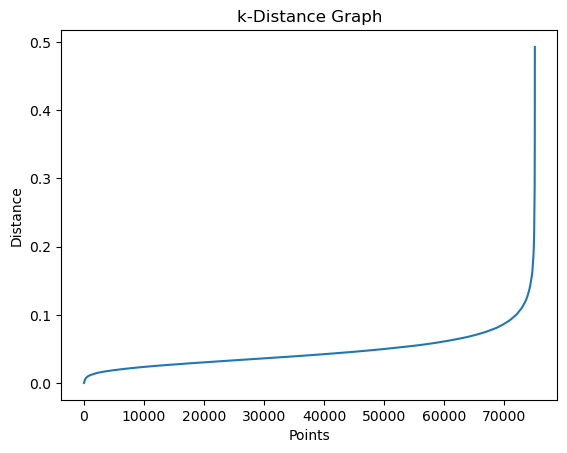

ε: 0.1, MinPts: 2, Silhouette Score: -0.6256400942802429
ε: 0.1, MinPts: 3, Silhouette Score: -0.5875394344329834
ε: 0.1, MinPts: 4, Silhouette Score: -0.5772731304168701
ε: 0.1, MinPts: 5, Silhouette Score: -0.5638283491134644
ε: 0.1, MinPts: 6, Silhouette Score: -0.5460410714149475
ε: 0.1, MinPts: 7, Silhouette Score: -0.4430147409439087
ε: 0.1, MinPts: 8, Silhouette Score: -0.4296482801437378
ε: 0.1, MinPts: 9, Silhouette Score: -0.3791479766368866
ε: 0.1, MinPts: 10, Silhouette Score: -0.32741397619247437
ε: 0.1, MinPts: 11, Silhouette Score: -0.26416873931884766
ε: 0.1, MinPts: 12, Silhouette Score: -0.2647618055343628
ε: 0.1, MinPts: 13, Silhouette Score: -0.2715582549571991
ε: 0.1, MinPts: 14, Silhouette Score: -0.26642948389053345
ε: 0.1, MinPts: 15, Silhouette Score: -0.24537646770477295
ε: 0.1, MinPts: 16, Silhouette Score: -0.26372742652893066
ε: 0.1, MinPts: 17, Silhouette Score: -0.2636004686355591
ε: 0.1, MinPts: 18, Silhouette Score: -0.2464868575334549
ε: 0.1, MinPts: 1

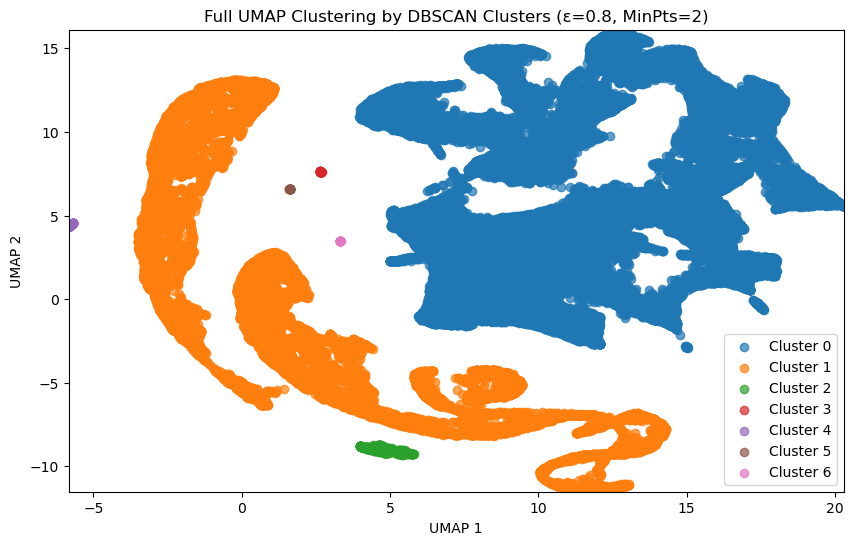

KeyError: 'MAX_SPEED'

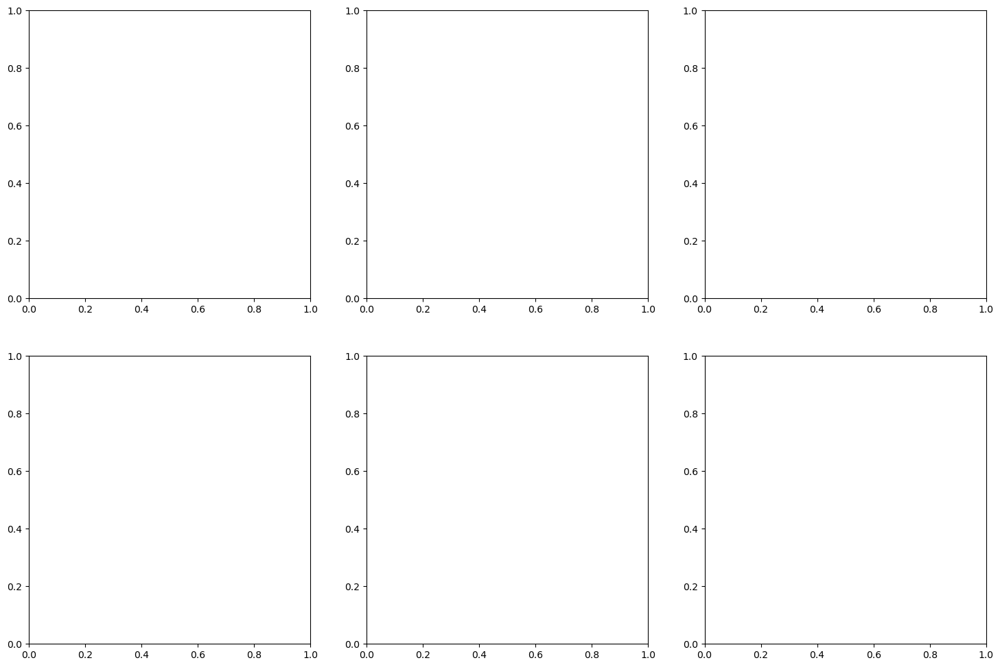

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score
import os
import umap

# Set a random seed for reproducibility
np.random.seed(42)

# Define the directory containing the Excel files
directory = 'R:/Lab Share/Seth/Computational/NK Cells/Heterogeneity/'

# Load the Excel files
file_names = [
    'kinetics_donor_1.xlsx',
    'kinetics_donor_2.xlsx',
    'kinetics_donor_3.xlsx',
    'kinetics_donor_4.xlsx'
]

# Read the Excel files into DataFrames
dfs = [pd.read_excel(os.path.join(directory, file)) for file in file_names]

# Fill missing values with the mean of each column for each DataFrame
filled_dfs = [df.fillna(df.mean()) for df in dfs]

# Add a column to each DataFrame to indicate the dataset of origin
for i, df in enumerate(filled_dfs):
    df['Dataset'] = f'Donor {i+1}'

# Concatenate all DataFrames into one pooled DataFrame
pooled_df = pd.concat(filled_dfs, axis=0)

# Remove the columns not needed for the analysis
pooled_df = pooled_df.drop(columns=['TRACK_X_LOCATION', 'TRACK_Y_LOCATION', 'TRACK_STOP', 'TRACK_START', 'TRACK_DURATION', 'TRACK_Z_LOCATION', 'NUMBER_MERGES', 'NUMBER_SPLITS', 'NUMBER_SPOTS', 
                                    'NUMBER_GAPS', 'NUMBER_COMPLEX'])

# Function to perform UMAP on the pooled dataset
def perform_umap(df):
    numeric_df = df.iloc[:, 3:-1]  # Select only numeric columns for UMAP (skip the first three non-numeric columns and the last column indicating dataset)
    
    # Standardize the data
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(numeric_df)
    
    # Perform UMAP with a fixed random seed for reproducibility
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(scaled_data)
    
    return embedding, scaled_data

# Perform UMAP on the pooled dataset
embedding, scaled_data = perform_umap(pooled_df)

# Create a DataFrame for the embedding
embedding_df = pd.DataFrame(embedding, columns=['UMAP 1', 'UMAP 2'])
embedding_df['Dataset'] = pooled_df['Dataset'].values

# Determine the coordinate limits for consistent scaling
x_min, x_max = embedding_df['UMAP 1'].min(), embedding_df['UMAP 1'].max()
y_min, y_max = embedding_df['UMAP 2'].min(), embedding_df['UMAP 2'].max()

# Optimize DBSCAN parameters using k-distance graph
def plot_k_distance_graph(data):
    neighbors = NearestNeighbors(n_neighbors=5)
    neighbors_fit = neighbors.fit(data)
    distances, indices = neighbors_fit.kneighbors(data)
    
    # Sort distances and plot k-distance graph
    distances = np.sort(distances[:, 4], axis=0)
    plt.plot(distances)
    plt.xlabel('Points')
    plt.ylabel('Distance')
    plt.title('k-Distance Graph')
    plt.show()

# Plot k-distance graph for the UMAP embedding
plot_k_distance_graph(embedding)

# Function to evaluate DBSCAN with different ε and MinPts values
def evaluate_dbscan_params(data, eps_values, minpts_values):
    best_score = -1
    best_params = None
    
    for eps in eps_values:
        for minpts in minpts_values:
            dbscan = DBSCAN(eps=eps, min_samples=minpts)
            clusters = dbscan.fit_predict(data)
            
            # Calculate silhouette score if there are more than one cluster
            if len(set(clusters)) > 1:
                score = silhouette_score(data, clusters)
                print(f'ε: {eps}, MinPts: {minpts}, Silhouette Score: {score}')
                
                if score > best_score:
                    best_score = score
                    best_params = (eps, minpts)
            else:
                print(f'ε: {eps}, MinPts: {minpts}, Only one cluster or noise detected')
    
    return best_params

# Range of ε and MinPts values to test
eps_values = np.arange(0.1, 1.0, 0.1)
minpts_values = range(2, 20)

# Evaluate DBSCAN with different ε and MinPts values and find the best parameters
best_params = evaluate_dbscan_params(embedding, eps_values, minpts_values)

if best_params:
    best_eps, best_minpts = best_params
    print(f'Optimal ε: {best_eps}, Optimal MinPts: {best_minpts}')
else:
    print('No suitable parameters found')

# Perform DBSCAN clustering with optimized parameters
if best_params:
    dbscan = DBSCAN(eps=best_eps, min_samples=best_minpts)
    clusters = dbscan.fit_predict(embedding)

    # Add cluster information to the embedding DataFrame
    embedding_df['Cluster'] = clusters

    # Plot full UMAP with color coding by DBSCAN clusters using Matplotlib with consistent scaling and different colors
    plt.figure(figsize=(10, 6))
    unique_clusters = np.unique(clusters)
    for cluster in unique_clusters:
        subset = embedding_df[embedding_df['Cluster'] == cluster]
        plt.scatter(subset['UMAP 1'], subset['UMAP 2'], label=f'Cluster {cluster}', alpha=0.7)
    plt.title(f'Full UMAP Clustering by DBSCAN Clusters (ε={best_eps}, MinPts={best_minpts})')
    plt.xlabel('UMAP 1')
    plt.ylabel('UMAP 2')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.legend()
    plt.show()

# List of specific parameters to display heatmaps for
parameters_to_display = ['MAX_SPEED', 'MEAN_SPEED', 'TOTAL_DISTANCE', 'CONFINEMENT_RATIO', 'LINEARITY_OF_PROGRESSION', 'MEAN_DIRECTIONAL_CHANGE']

# Plot UMAP heatmaps for each specified parameter in each cluster identified by KMeans for each individual donor using inferno colormap and compile them into a single plot per donor
for donor in pooled_df['Dataset'].unique():
    donor_embedding_df = embedding_df[embedding_df['Dataset'] == donor]
    donor_scaled_data = scaled_data[embedding_df['Dataset'] == donor]
    
    num_cols = len(parameters_to_display)
    num_rows = (num_cols + 2) // 3
    
    fig, axes = plt.subplots(num_rows, 3, figsize=(18, num_rows * 6))
    axes = axes.flatten()
    
    for i, col in enumerate(parameters_to_display):
        ax = axes[i]
        sc = ax.scatter(donor_embedding_df['UMAP 1'], donor_embedding_df['UMAP 2'], c=donor_scaled_data[:, pooled_df.columns.get_loc(col) - 3], cmap='inferno', alpha=0.7)
        fig.colorbar(sc, ax=ax, label=col)
        ax